In [1]:
import cv2
import logging
import matplotlib.patches as patches
import matplotlib.pyplot as plt
import numpy as np
import os
import pandas as pd
import pydicom
import random
from glob import glob
from matplotlib import animation
from matplotlib.pyplot import rc
from pathlib import Path
from PIL import Image
from scipy.ndimage import gaussian_filter, gaussian_filter1d, rotate, zoom
from scipy.signal import find_peaks
from skimage import exposure, filters
from skimage.feature import graycomatrix, graycoprops, hog
from sklearn.decomposition import PCA
from sklearn.ensemble import GradientBoostingClassifier, RandomForestClassifier, VotingClassifier
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import cross_val_score, train_test_split
from sklearn.neural_network import MLPClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
from tqdm import tqdm
from typing import Dict, List, Tuple
import joblib
import re
from collections import defaultdict


In [2]:
BASE_URL = '/kaggle/input/rsna-2024-lumbar-spine-degenerative-classification/'
EPS = 1e-6
GRAYSCALE = 255

NUM_LABELS_SAGITTAL_T1 = 3
NUM_LABELS_AXIAL_T2 = 3
NORMALISE_COORDINATES = False

SAGITTAL_IMAGE_SHAPE = (490, 275) # based on an image that was (620, 620), height first then width
SAGITTAL_START_X = 0.4
SAGITTAL_END_X = 0.8
SAGITTAL_START_Y = 0.1
SAGITTAL_END_Y = 0.9
NUM_IMAGES_SAGITTAL_T2 = 3
NUM_IMAGES_SAGITTAL_T1 = 3

AXIAL_IMAGE_SHAPE = (310, 250) # based on an image that was (620, 620), height first then width
AXIAL_START_X = 0.3
AXIAL_END_X = 0.7
AXIAL_START_Y = 1.0 - 0.85
AXIAL_END_Y = 1.0 - 0.35
NUM_IMAGES_AXIAL_T2 = 3 # we are excluding all scans that have less than 15 images this way


In [3]:
train_df = pd.read_csv(f'{BASE_URL}train.csv')
train_descriptions = pd.read_csv(f'{BASE_URL}train_series_descriptions.csv')
coordinates_df = pd.read_csv(f'{BASE_URL}train_label_coordinates.csv')

In [4]:
coordinates_df = pd.merge(coordinates_df, train_descriptions, on = ['study_id', 'series_id'])
coordinates_df.head()

,study_id,series_id,instance_number,condition,level,x,y,series_description
0,4003253,702807833,8,Spinal Canal Stenosis,L1/L2,322.831858,227.964602,Sagittal T2/STIR
1,4003253,702807833,8,Spinal Canal Stenosis,L2/L3,320.571429,295.714286,Sagittal T2/STIR
2,4003253,702807833,8,Spinal Canal Stenosis,L3/L4,323.030303,371.818182,Sagittal T2/STIR
3,4003253,702807833,8,Spinal Canal Stenosis,L4/L5,335.292035,427.327434,Sagittal T2/STIR
4,4003253,702807833,8,Spinal Canal Stenosis,L5/S1,353.415929,483.964602,Sagittal T2/STIR


In [5]:
def get_image_size(study_id, series_id, instance_number = 1):
    path = f'{BASE_URL}train_images/{study_id}/{series_id}/{instance_number}.dcm'
    try:
        image_array = pydicom.dcmread(path).pixel_array
        return image_array.shape
    except:
        print(f'study id {study_id}, series id {series_id} has no instance number {instance_number}')

In [6]:
if NORMALISE_COORDINATES:
    # Normalize the x and y values
    coordinates_df['height'], coordinates_df['width'] = zip(*coordinates_df.apply(lambda row: get_image_size(row['study_id'], row['series_id'], row['instance_number']), axis=1))
    coordinates_df['x_normalized'] = coordinates_df['x'] / coordinates_df['width']
    coordinates_df['y_normalized'] = coordinates_df['y'] / coordinates_df['height']

In [7]:
sagittal_t2_coordinates = coordinates_df[coordinates_df['series_description'] == 'Sagittal T2/STIR']
sagittal_t1_coordinates = coordinates_df[coordinates_df['series_description'] == 'Sagittal T1']
axial_t2_coordinates = coordinates_df[coordinates_df['series_description'] == 'Axial T2']

### Since the images will be cropped, we will need to adjust the coordinates and export them

In [8]:
new_sagittal_t2_coordinates = sagittal_t2_coordinates.copy()
new_sagittal_t1_coordinates = sagittal_t1_coordinates.copy()
new_axial_t2_coordinates = axial_t2_coordinates.copy()

In [9]:
LEVELS = ['L1/L2', 'L2/L3', 'L3/L4', 'L4/L5', 'L5/S1']

In [10]:
def atoi(text):
    return int(text) if text.isdigit() else text

def natural_keys(text):
    return [ atoi(c) for c in re.split(r'(\d+)', text) ]

In [11]:
os.makedirs('Updated_coordinates', exist_ok=True)
os.makedirs('Detected_levels', exist_ok=True)
os.makedirs('Models', exist_ok=True)

In [12]:
def are_all_entries_same(series: pd.Series):
    array = series.to_numpy()
    return (array[0] == array).all()

# Sagittal T2

## Helper functions

In [13]:
def analyze_image(image):
    """Analyze image properties to determine the best normalization method."""
    
    histogram = cv2.calcHist([image], [0], None, [256], [0, 256])
    histogram = histogram.flatten() / histogram.sum()
    
    # Calculate image statistics
    mean = np.mean(image)
    std = np.std(image)
    dynamic_range = image.max() - image.min()
    
    # Calculate histogram entropy
    entropy = -np.sum(histogram * np.log2(histogram + 1e-7))
    
    return {
        'mean': mean,
        'std': std,
        'dynamic_range': dynamic_range,
        'entropy': entropy
    }

def adaptive_normalize_image(image, lower_percentile=1, upper_percentile=99):
    """
    Dynamically choose and apply the best normalization method based on image properties.
    """
    # Ensure image is in float format and in range [0, 1]
    min_val = image.min()
    max_val = image.max()
    eps = 1e-6  # Small epsilon value to avoid division by near-zero
    if max_val - min_val > eps:
        image_float = ((image - min_val) / (max_val - min_val)).astype(float)
    else:
        # If all pixels have very similar values, return a uniform image
        return np.zeros_like(image, dtype=np.uint8)
    
    # Analyze image
    stats = analyze_image((image_float * 255).astype(np.uint8))
    
    # Determine normalization method based on image properties
    if stats['dynamic_range'] < 75:  # Low contrast image
        return exposure.equalize_adapthist(image_float, clip_limit=0.03)
    elif stats['entropy'] < 6:  # Image with limited intensity levels
        return exposure.equalize_hist(image_float)
    elif stats['mean'] < 50 and stats['std'] < 30:  # Dark image with low variance
        # Apply gamma correction
        gamma = 1 - stats['mean'] / 255  # Adaptive gamma
        return exposure.adjust_gamma(image_float, gamma)
    elif stats['mean'] > 150:  # Very bright image
        # Apply logarithmic correction
        return exposure.adjust_log(image_float, 1)
    else:
        # For well-balanced images, apply mild contrast stretching
        p_low, p_high = np.percentile(image_float, (lower_percentile, upper_percentile))
        return exposure.rescale_intensity(image_float, in_range=(p_low, p_high))

# Final normalization function
def normalize_image(image):
    normalized = adaptive_normalize_image(image)
    return (normalized * 255).astype(np.uint8)

In [14]:
# currently handles only the '@target_num_images' = 3 well
def select_closest_images(images, center, target_num_images, preferred_direction='center'):
    '''Select target_num_images around the center image, with preference for a direction'''
    assert preferred_direction in ['center', 'left', 'right']
    assert 0 <= center < len(images)
    assert target_num_images <= len(images)

    if target_num_images % 2 == 0:
        left_pad = right_pad = target_num_images // 2
    else:
        left_pad = right_pad = target_num_images // 2
        if preferred_direction == 'left':
            left_pad += 1
        else:
            right_pad += 1

    start = max(0, center - left_pad)
    end = min(len(images), center + right_pad + 1)

    if end - start < target_num_images:
        if start == 0:
            end = target_num_images
        else:
            start = len(images) - target_num_images

    selected_images = images[start:end]

    # Adjust if we have too many images
    if len(selected_images) > target_num_images:
        if preferred_direction == 'left':
            selected_images = selected_images[:target_num_images]
        elif preferred_direction == 'right':
            selected_images = selected_images[-target_num_images:]
        else:  # center
            excess = len(selected_images) - target_num_images
            selected_images = selected_images[excess//2 : -(excess-excess//2)]

    assert len(selected_images) == target_num_images
    return selected_images

In [15]:
def crop_sagittal_images(images, lower_percentile=20, upper_percentile=95, sigma=1, target_width_ratio=0.6, padding_ratio=0.1, edge_threshold=10):
    """
    Detect the x-range and y-range by looking at the brightness of the normalized images,
    center the spine, crop to a target width ratio, add padding, and remove dark edges.
    Returns the cropped images and the start coordinates.
    """
    
    num_images = len(images)
    image = images[num_images // 2]
    assert np.sum(image) > 0
    
    # Determine the horizontal and vertical ranges
    vertical_median = np.median(image, axis=0)
    
    # Detect and remove dark edges
    left_edge = 0
    right_edge = image.shape[1] - 1
    top_edge = 0
    bottom_edge = image.shape[0] - 1
    
    while left_edge < image.shape[1] and np.mean(image[:, left_edge]) < edge_threshold:
        left_edge += 1
    
    while right_edge > 0 and np.mean(image[:, right_edge]) < edge_threshold:
        right_edge -= 1
    
    while top_edge < image.shape[0] and np.mean(image[top_edge, :]) < edge_threshold:
        top_edge += 1
    
    while bottom_edge > 0 and np.mean(image[bottom_edge, :]) < edge_threshold:
        bottom_edge -= 1
    
    # Focus on the central region of the image
    center_x = (left_edge + right_edge) // 2
    central_width = (right_edge - left_edge) // 2
    central_start = max(left_edge, center_x - central_width // 2)
    central_end = min(right_edge, center_x + central_width // 2)
    
    # Use dynamic thresholding based on the central region
    central_vertical_median = vertical_median[central_start:central_end]
    lower_threshold = np.percentile(central_vertical_median, lower_percentile)
    upper_threshold = np.percentile(central_vertical_median, upper_percentile)
    
    smoothed_median = gaussian_filter(central_vertical_median, sigma=sigma)
    
    # Find regions above lower threshold and below upper threshold in the central region
    relevant_indices = np.where((smoothed_median > lower_threshold) & (smoothed_median < upper_threshold))[0]
    
    if len(relevant_indices) == 0:
        # If no relevant region is found, use the full central width
        x_start = central_start
        x_end = central_end
    else:
        x_start = central_start + relevant_indices[0]
        x_end = central_start + relevant_indices[-1]
    
    # Calculate the center of the detected region
    center = (x_start + x_end) // 2
    
    # Calculate the target width (minimum half of the original width)
    target_width = max(int(target_width_ratio * (right_edge - left_edge)), (right_edge - left_edge) // 2)
    
    # Calculate padding
    padding = int(padding_ratio * (right_edge - left_edge))
    
    # Detect and exclude bright noisy regions on the left
    left_region = vertical_median[left_edge:center]
    left_smoothed = gaussian_filter(left_region, sigma=sigma)
    left_bright_threshold = np.percentile(left_smoothed, 98)  # Adjust this percentile as needed
    left_bright_indices = np.where(left_smoothed > left_bright_threshold)[0]
    
    if len(left_bright_indices) > 0:
        # Find the rightmost bright region on the left
        last_bright_left = left_bright_indices[-1] + left_edge
        # Adjust x_start to exclude the bright region
        x_start = max(x_start, last_bright_left)
    
    # Detect and exclude bright noisy regions on the right
    right_region = vertical_median[center:right_edge]
    right_smoothed = gaussian_filter(right_region, sigma=sigma)
    right_bright_threshold = np.percentile(right_smoothed, 98)  # Adjust this percentile as needed
    right_bright_indices = np.where(right_smoothed > right_bright_threshold)[0]
    
    if len(right_bright_indices) > 0:
        # Find the leftmost bright region on the right
        first_bright_right = right_bright_indices[0] + center
        # Adjust x_end to exclude the bright region
        x_end = min(x_end, first_bright_right)
    
    # Ensure the spine is centered in the final crop
    crop_width = min(target_width, x_end - x_start)
    center = (x_start + x_end) // 2
    x_start = max(left_edge, center - crop_width // 2 - padding)
    x_end = min(right_edge, x_start + crop_width + 2 * padding)
    
    # Ensure the crop is at least 1/3 of the original width
    min_crop_width = image.shape[1] // 3
    crop_width = max(crop_width, min_crop_width)
    
    x_start = max(left_edge, center - crop_width // 2 - padding)
    x_end = min(right_edge, x_start + crop_width + 2 * padding)
    
    # If the crop is still too narrow, expand it while keeping the center
    if x_end - x_start < min_crop_width:
        extra_width = min_crop_width - (x_end - x_start)
        x_start = max(left_edge, x_start - extra_width // 2)
        x_end = min(right_edge, x_end + extra_width // 2)
        
        # If we hit the image edges, shift the crop to ensure minimum width
        if x_start == left_edge:
            x_end = min(right_edge, x_start + min_crop_width)
        elif x_end == right_edge:
            x_start = max(left_edge, x_end - min_crop_width)
    # Ensure the crop is at least half the original width
    if x_end - x_start < (right_edge - left_edge) // 2:
        extra_width = ((right_edge - left_edge) // 2) - (x_end - x_start)
        x_start = max(left_edge, x_start - extra_width // 2)
        x_end = min(right_edge, x_end + extra_width // 2)
    
    # Adjust vertical cropping
    y_start = max(top_edge, int(SAGITTAL_START_Y * image.shape[0]))
    y_end = min(bottom_edge, int(SAGITTAL_END_Y * image.shape[0]))
    
    return [[image[y_start:y_end, x_start:x_end] for image in images], (x_start, y_start)]

Processing scans:   0%|          | 0/10 [00:00<?, ?it/s]

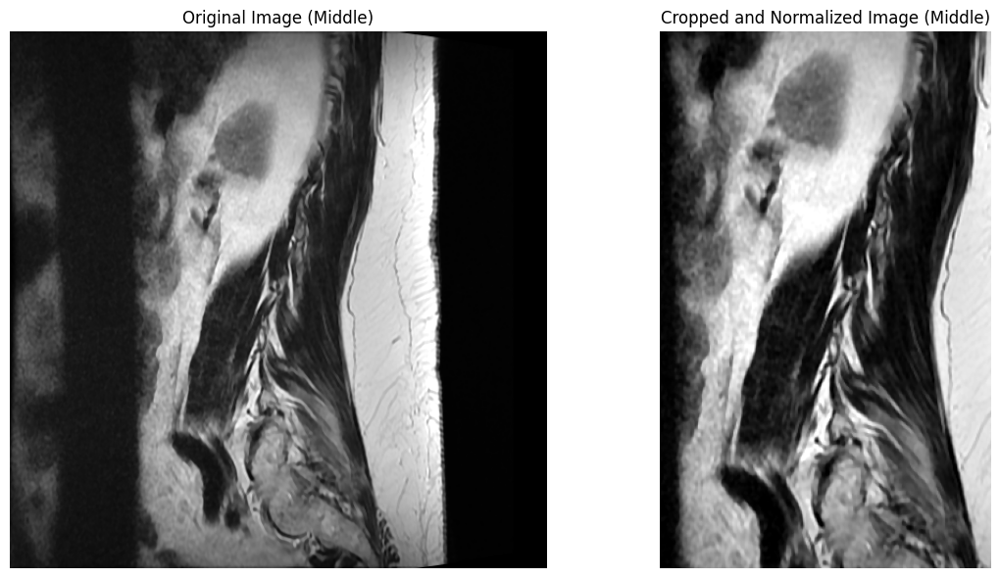

Processing scans:  10%|█         | 1/10 [00:01<00:13,  1.54s/it]

Study ID: 3563559233, Series ID: 2004493529
Cropping started at (x, y) = (108, 51)
Original shape: (512, 512), Cropped shape: (409, 252)


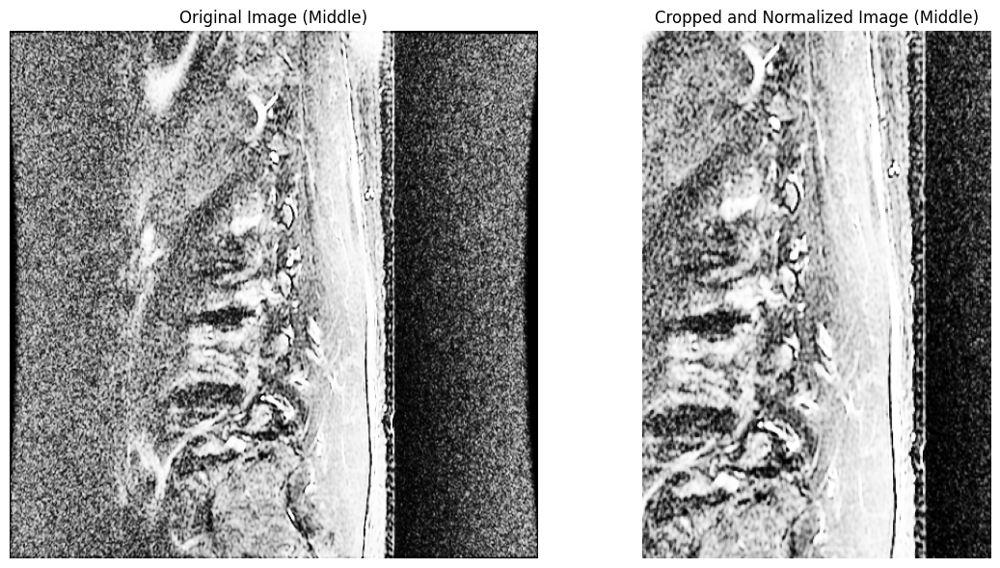

Processing scans:  20%|██        | 2/10 [00:03<00:12,  1.59s/it]

Study ID: 3239069834, Series ID: 2352610120
Cropping started at (x, y) = (154, 51)
Original shape: (512, 512), Cropped shape: (409, 270)


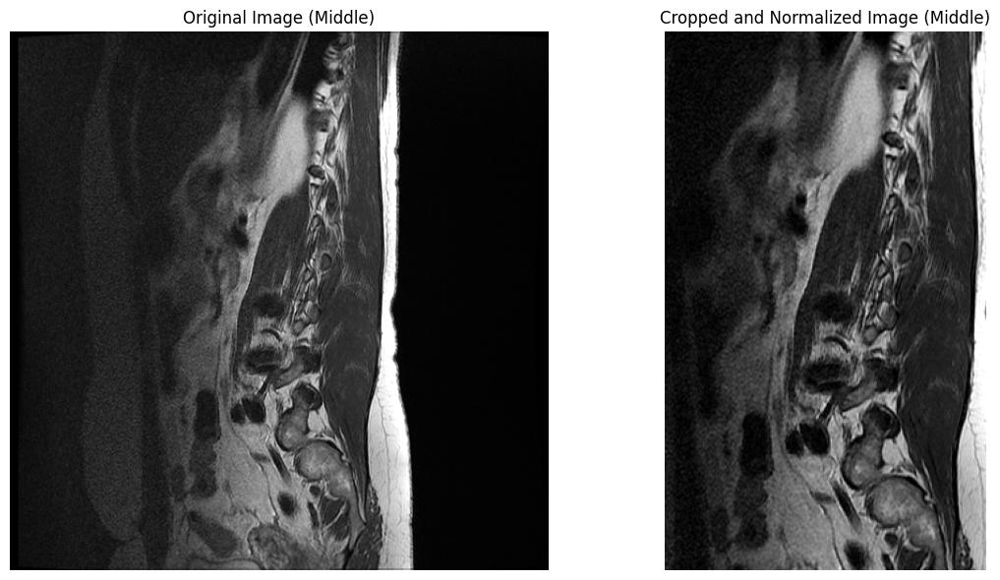

Processing scans:  30%|███       | 3/10 [00:04<00:09,  1.41s/it]

Study ID: 2681235806, Series ID: 3746931092
Cropping started at (x, y) = (118, 51)
Original shape: (512, 512), Cropped shape: (409, 244)


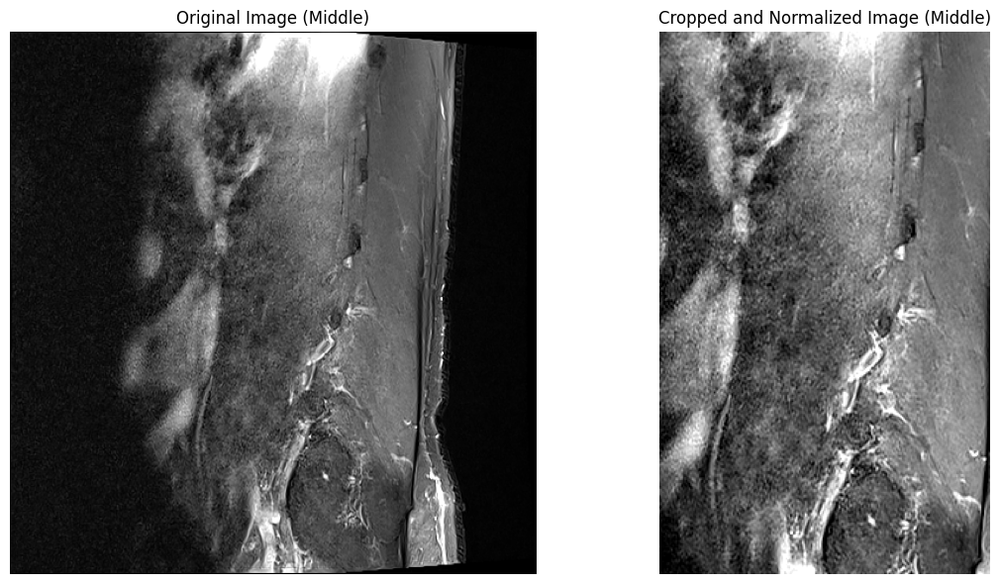

Processing scans:  40%|████      | 4/10 [00:05<00:08,  1.35s/it]

Study ID: 3074721194, Series ID: 1692142092
Cropping started at (x, y) = (124, 46)
Original shape: (462, 448), Cropped shape: (369, 225)


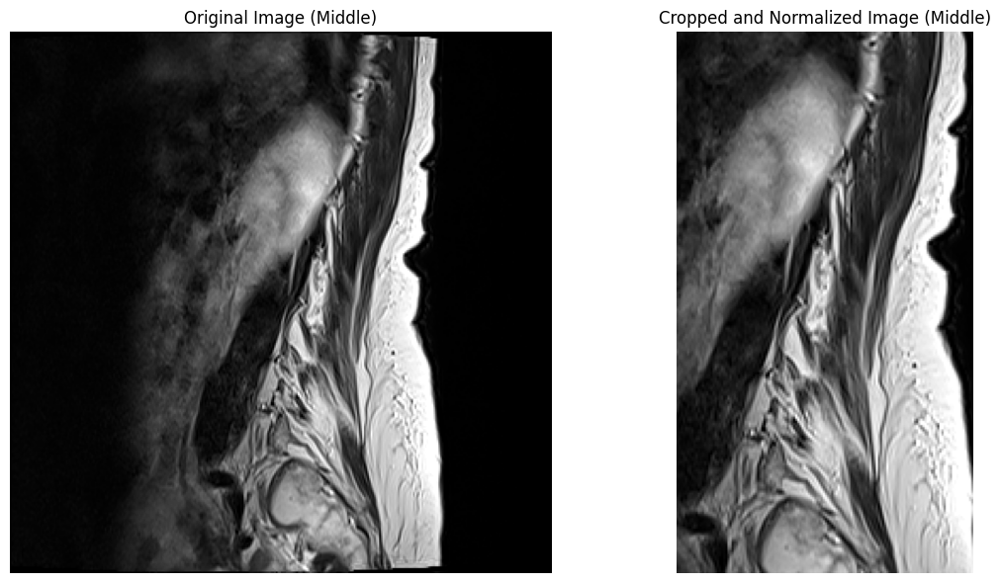

Processing scans:  50%|█████     | 5/10 [00:06<00:06,  1.28s/it]

Study ID: 859570985, Series ID: 3864929575
Cropping started at (x, y) = (114, 32)
Original shape: (320, 320), Cropped shape: (256, 140)


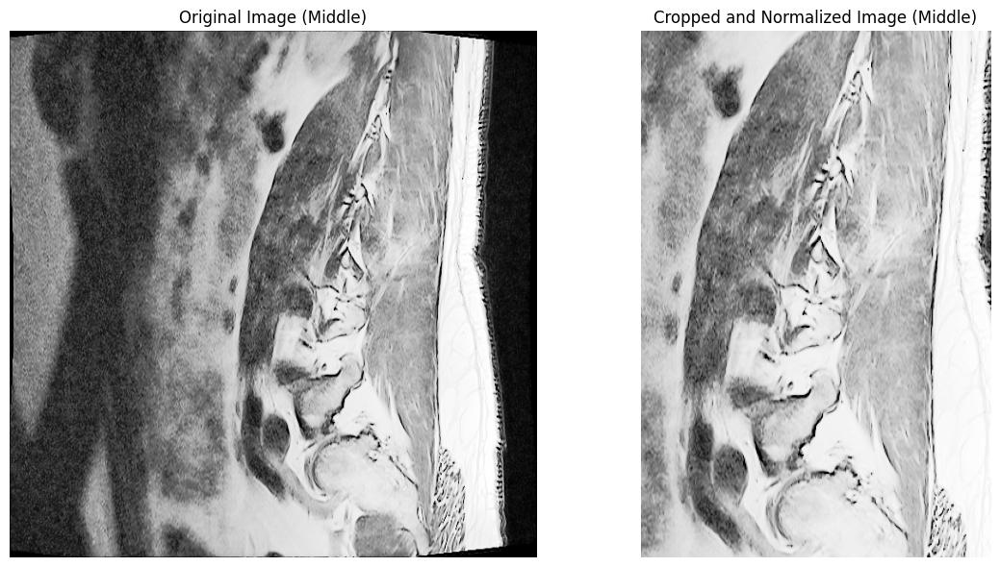

Processing scans:  60%|██████    | 6/10 [00:08<00:06,  1.53s/it]

Study ID: 106310815, Series ID: 2473102710
Cropping started at (x, y) = (213, 57)
Original shape: (576, 576), Cropped shape: (461, 306)


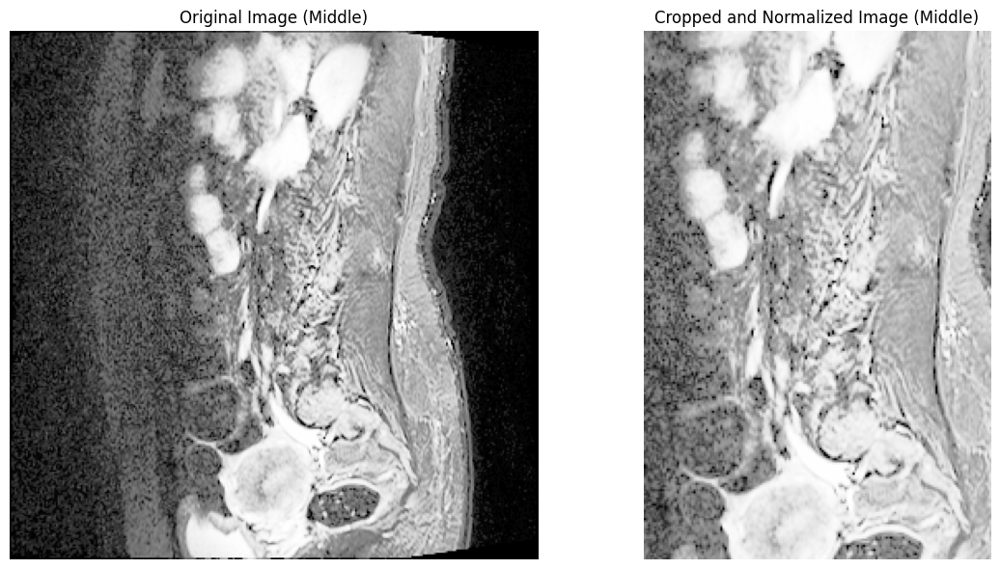

Processing scans:  70%|███████   | 7/10 [00:09<00:04,  1.35s/it]

Study ID: 3332550698, Series ID: 760889960
Cropping started at (x, y) = (89, 32)
Original shape: (320, 320), Cropped shape: (256, 168)


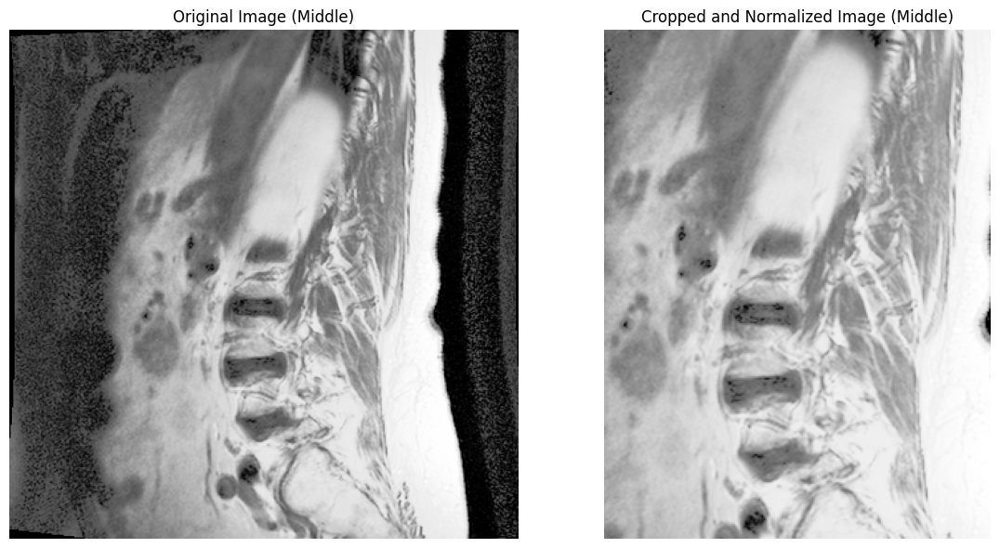

Processing scans:  80%|████████  | 8/10 [00:10<00:02,  1.28s/it]

Study ID: 3697763310, Series ID: 3535737253
Cropping started at (x, y) = (90, 38)
Original shape: (384, 384), Cropped shape: (307, 233)


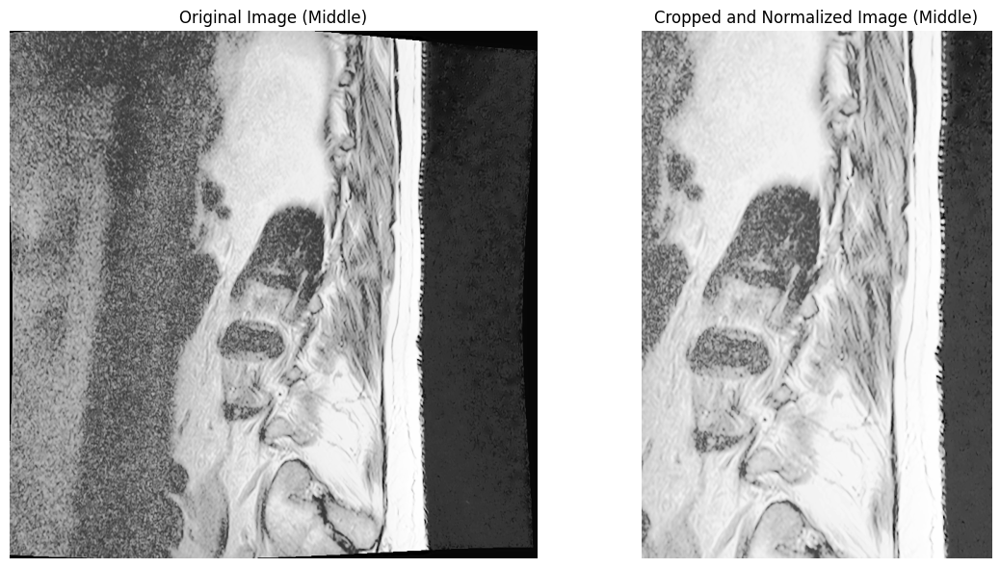

Processing scans:  90%|█████████ | 9/10 [00:14<00:01,  1.89s/it]

Study ID: 1618233546, Series ID: 2816981416
Cropping started at (x, y) = (250, 76)
Original shape: (768, 768), Cropped shape: (615, 408)


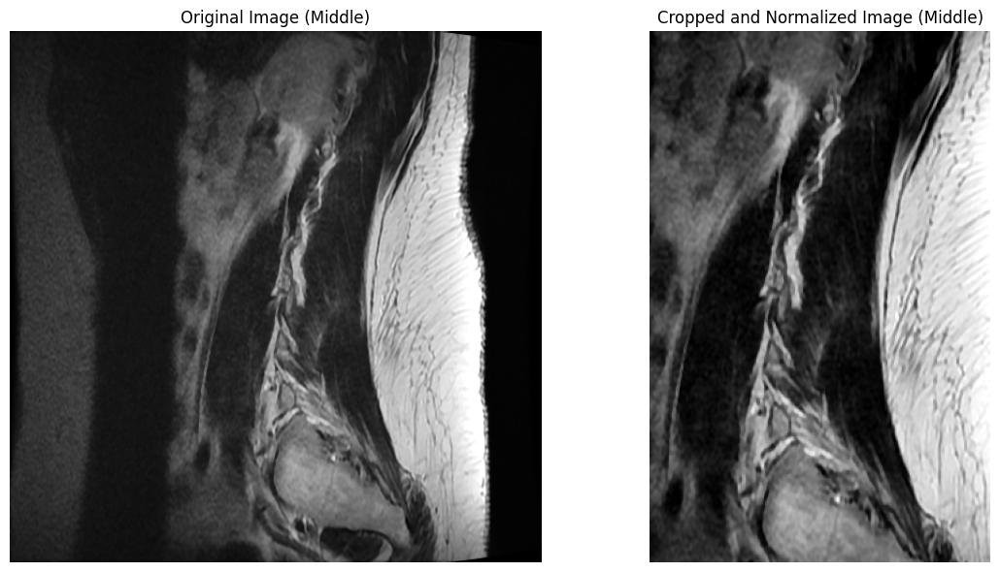

Processing scans: 100%|██████████| 10/10 [00:15<00:00,  1.56s/it]

Study ID: 2557856398, Series ID: 4039514140
Cropping started at (x, y) = (167, 51)
Original shape: (512, 512), Cropped shape: (409, 262)


In [16]:
logging.basicConfig(filename='crop_test.log', level=logging.INFO)

def set_seed(seed):
    random.seed(seed)
    np.random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)

def load_dicom_series(study_id, series_id, base_folder):
    folder_path = Path(base_folder) / str(study_id) / str(series_id)
    image_files = sorted(folder_path.glob('*.dcm'))
    images = [normalize_image(pydicom.dcmread(str(f)).pixel_array) for f in image_files]
    return images

def test_crop_sagittal_images(study_id, series_id, base_folder):
    # Load the entire DICOM series
    images = load_dicom_series(study_id, series_id, base_folder)
    
    # Apply cropping
    cropped_images, (x_start, y_start) = crop_sagittal_images(images)
    
    # Normalize the cropped images
    normalized_cropped_images = [normalize_image(img) for img in cropped_images]
    
    # Display result for the middle image
    middle_idx = len(images) // 2
    
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))
    
    ax1.imshow(images[middle_idx], cmap='gray')
    ax1.set_title(f'Original Image (Middle)')
    ax1.axis('off')
    
    ax2.imshow(normalized_cropped_images[middle_idx], cmap='gray')
    ax2.set_title(f'Cropped and Normalized Image (Middle)')
    ax2.axis('off')
    
    plt.tight_layout()
    plt.show()
    
    print(f"Study ID: {study_id}, Series ID: {series_id}")
    print(f"Cropping started at (x, y) = ({x_start}, {y_start})")
    print(f"Original shape: {images[0].shape}, Cropped shape: {normalized_cropped_images[0].shape}")

def test_multiple_scans(descriptions_df, base_folder, num_scans=5, random_seed=None):
    # Filter for Sagittal T2 scans
    sagittal_t2_df = descriptions_df[descriptions_df['series_description'] == 'Sagittal T2/STIR']
    
    # Set random seed for reproducibility
    if random_seed is not None:
        set_seed(random_seed)
    
    # Randomly sample scans
    sampled_scans = sagittal_t2_df.sample(n=min(num_scans, len(sagittal_t2_df)), random_state=random_seed)
    
    for _, row in tqdm(sampled_scans.iterrows(), total=len(sampled_scans), desc="Processing scans"):
        try:
            study_id = row['study_id']
            series_id = row['series_id']
            logging.info(f"Processing: Study ID {study_id}, Series ID {series_id}")
            test_crop_sagittal_images(study_id, series_id, base_folder)
        except Exception as e:
            logging.error(f"Error processing Study ID {study_id}, Series ID {series_id}: {str(e)}")

# Run the test on multiple scans
base_folder = f'{BASE_URL}train_images/'
test_multiple_scans(train_descriptions, base_folder, num_scans=10, random_seed=569)  # Adjust num_scans as needed

## Training model to predict the instance number

/opt/conda/lib/python3.10/site-packages/sklearn/model_selection/_split.py:700: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(


Cross-validation RMSE: 0.93 (+/- 0.47)
Testing Best Ensemble Model:


Processing studies: 100%|██████████| 50/50 [01:07<00:00,  1.34s/it]


Root Mean Squared Error: 0.00
Custom Accuracy: 100.00%


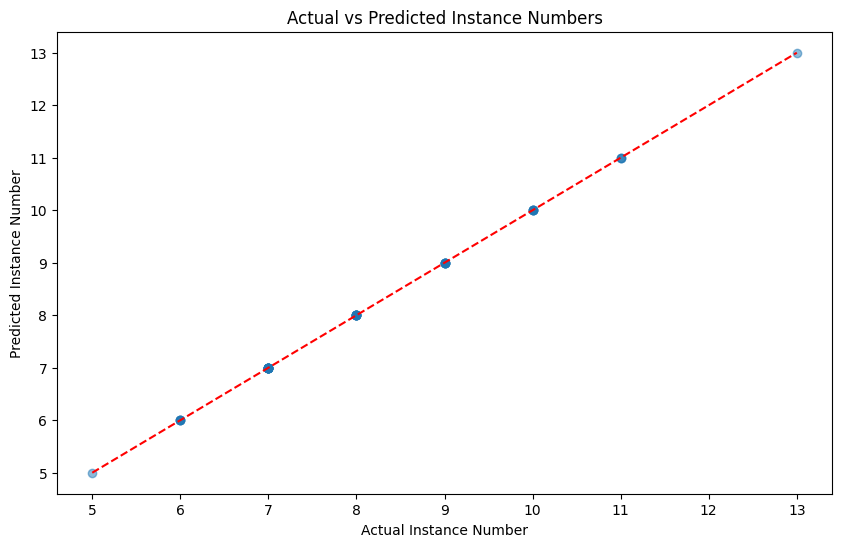

In [17]:
STANDARD_SIZE = (320, 200)

def preprocess_images(scan_images):
    """Resize all images to a standard size."""
    return [cv2.resize(img, STANDARD_SIZE, interpolation=cv2.INTER_CUBIC) for img in scan_images]

def extract_advanced_features(scan_images):
    # Preprocess images to ensure they all have the same shape
    scan_images = preprocess_images(scan_images)
    
    # Calculate features for each image in the scan
    all_image_features = []
    for img in scan_images:
        h, w = img.shape
        center_region = img[:, w//4:3*w//4]
        
        # Simple features for each image
        vertical_profile = np.mean(center_region, axis=1)
        peaks, _ = find_peaks(vertical_profile, distance=20)
        edges = filters.sobel(center_region)
        
        image_features = [
            np.mean(vertical_profile),
            np.std(vertical_profile),
            len(peaks),  # number of potential vertebrae
            np.mean(edges),  # edge intensity
            np.mean(center_region),  # mean intensity
            np.std(center_region),  # intensity standard deviation
        ]
        all_image_features.append(image_features)
    
    # Find the image with the most prominent spine features
    spine_scores = [f[2] * f[3] for f in all_image_features]  # Score based on vertebrae count and edge intensity
    best_spine_index = np.argmax(spine_scores)
    
    # Use the image with the most prominent spine for detailed feature extraction
    image = scan_images[best_spine_index]
    h, w = image.shape
    center_region = image[:, w//4:3*w//4]
    
    # Detailed feature extraction
    vertical_profile = np.mean(center_region, axis=1)
    peaks, _ = find_peaks(vertical_profile, distance=20)
    num_vertebrae = len(peaks)
    
    if len(peaks) > 2:
        spine_curve = np.polyfit(peaks, range(len(peaks)), 2)
        curvature = spine_curve[0]
    else:
        curvature = 0
    
    glcm = graycomatrix(center_region.astype(np.uint8), [1], [0, np.pi/2], levels=256, symmetric=True, normed=True)
    contrast = graycoprops(glcm, 'contrast').mean()
    homogeneity = graycoprops(glcm, 'homogeneity').mean()
    
    edges = filters.sobel(center_region)
    edge_intensity = np.mean(edges)
    
    left_half = center_region[:, :center_region.shape[1]//2]
    right_half = np.fliplr(center_region[:, center_region.shape[1]//2:])
    symmetry = np.mean(np.abs(left_half - right_half))
    
    mean_intensity = np.mean(center_region)
    std_intensity = np.std(center_region)
    
    hog_features = hog(center_region, orientations=9, pixels_per_cell=(16, 16), cells_per_block=(2, 2), visualize=False)
    
    # Combine detailed features with overall scan features
    features = np.array([
        np.mean(vertical_profile),
        np.std(vertical_profile),
        num_vertebrae,
        curvature,
        contrast,
        homogeneity,
        edge_intensity,
        symmetry,
        mean_intensity,
        std_intensity,
        *hog_features[:10],  # Include first 10 HOG features
        len(scan_images),  # Total number of images in the scan
        best_spine_index,  # Index of the image with the most prominent spine
        np.mean([f[0] for f in all_image_features]),  # Average mean intensity across all images
        np.mean([f[1] for f in all_image_features]),  # Average intensity std across all images
        np.mean([f[2] for f in all_image_features]),  # Average number of potential vertebrae across all images
        np.mean([f[3] for f in all_image_features]),  # Average edge intensity across all images
    ])
    
    return features

def augment_scan(scan_images):
    """Augment the scan images and ensure they all have the same shape."""
    augmented = []
    for img in scan_images:
        # Rotation
        rotated = rotate(img, angle=10, reshape=False)
        augmented.append(cv2.resize(rotated, STANDARD_SIZE, interpolation=cv2.INTER_CUBIC))
        
        # Zoom
        zoomed = zoom(img, 1.1, order=3)
        augmented.append(cv2.resize(zoomed, STANDARD_SIZE, interpolation=cv2.INTER_CUBIC))
        
        # Flip
        flipped = np.fliplr(img)
        augmented.append(cv2.resize(flipped, STANDARD_SIZE, interpolation=cv2.INTER_CUBIC))
    
    return scan_images + augmented

def collect_scan_data():
    scan_features = []
    scan_labels = []
    
    grouped = sagittal_t2_coordinates.groupby(['study_id', 'series_id'])
    
    for (study_id, series_id), group in tqdm(grouped, desc="Collecting scan data"):
        image_paths = glob(f'{BASE_URL}/train_images/{study_id}/{series_id}/*.dcm')
        image_paths.sort(key=natural_keys)
        
        if len(image_paths) == 0:
            print(f"No images found for study {study_id}, series {series_id}")
            continue
        
        # Load and normalize images before cropping
        images = []
        for path in image_paths:
            img = pydicom.dcmread(path).pixel_array
            normalized = normalize_image(img)
            images.append(normalized)
        
        # Crop images
        cropped_images, _ = crop_sagittal_images(images)
        
        # Normalize images after cropping
        normalized_images = []
        for img in cropped_images:
            normalized = normalize_image(img)
            normalized_images.append(normalized)
        
        # Ensure all images have the same shape
        normalized_images = preprocess_images(normalized_images)
        
        # Data augmentation
        augmented_images = augment_scan(normalized_images)
        
        # Extract features for the entire scan
        features = extract_advanced_features(augmented_images)
        
        # Get the labeled instance number
        labeled_instance = group['instance_number'].iloc[0] - 1  # Subtract 1 as instance numbers start from 1
        
        # Check if labeled_instance is valid
        if labeled_instance < 0 or labeled_instance >= len(normalized_images):
            print(f"Invalid instance number for study {study_id}, series {series_id}. Skipping.")
            continue
        
        scan_features.append(features)
        scan_labels.append(labeled_instance)
    
    return np.array(scan_features), np.array(scan_labels)

# Collect scan-level data
scan_features, scan_labels = collect_scan_data()

# Feature scaling
scaler = StandardScaler()
scaled_features = scaler.fit_transform(scan_features)

# Dimensionality reduction
pca = PCA(n_components=0.95)  # Retain 95% of variance
reduced_features = pca.fit_transform(scaled_features)

best_params =  {
    'gb__learning_rate': 0.03221339552022711, 
    'gb__n_estimators': 330, 
    'mlp__alpha': 0.006610770255019445, 
    'mlp__hidden_layer_sizes': (109, 30), 
    'rf__max_depth': 43, 
    'rf__n_estimators': 427, 
    'svm__C': 4.594506741382034, 
    'svm__kernel': 'rbf'
}


# Create the ensemble model with best parameters
def create_best_ensemble_model(best_params):
    rf = RandomForestClassifier(n_estimators=best_params['rf__n_estimators'], 
                                max_depth=best_params['rf__max_depth'], 
                                random_state=42)
    gb = GradientBoostingClassifier(n_estimators=best_params['gb__n_estimators'], 
                                    learning_rate=best_params['gb__learning_rate'], 
                                    random_state=42)
    svm = SVC(C=best_params['svm__C'], 
              kernel=best_params['svm__kernel'], 
              probability=True, 
              random_state=42)
    mlp = MLPClassifier(hidden_layer_sizes=best_params['mlp__hidden_layer_sizes'], 
                        alpha=best_params['mlp__alpha'], 
                        max_iter=1000, 
                        random_state=42)
    
    ensemble = VotingClassifier(
        estimators=[('rf', rf), ('gb', gb), ('svm', svm), ('mlp', mlp)],
        voting='soft'
    )
    
    return ensemble

# Create the best model
best_model = create_best_ensemble_model(best_params)

# Perform cross-validation
cv_scores = cross_val_score(best_model, reduced_features, scan_labels, cv=5, scoring='neg_mean_squared_error')
print(f"Cross-validation RMSE: {np.sqrt(-cv_scores.mean()):.2f} (+/- {np.sqrt(cv_scores.std() * 2):.2f})")

# Train the model on the entire dataset
best_model.fit(reduced_features, scan_labels)

# Save the trained model
joblib.dump(best_model, 'Models/sagittal_t2_model.joblib')

# Update the prediction function
def predict_instance_number_sagittal_t2(scan_images):
    features = extract_advanced_features(scan_images)
    features = features.reshape(1, -1)
    features = scaler.transform(features)
    reduced_features = pca.transform(features)
    return best_model.predict(reduced_features)[0]

# Custom accuracy function
def custom_accuracy(y_true, y_pred):
    exact = np.sum(np.abs(y_true - y_pred) == 0)
    off_by_one = np.sum(np.abs(y_true - y_pred) == 1)
    total = len(y_true)
    
    accuracy = (exact + 0.5 * off_by_one) / total
    return accuracy

# Test function
def test_find_instance_number(num_samples=50, model=best_model):
    random.seed(42)
    unique_studies = sagittal_t2_coordinates['study_id'].unique()
    sampled_studies = random.sample(list(unique_studies), min(num_samples, len(unique_studies)))
    
    actual_instances = []
    predicted_instances = []
    
    for study_id in tqdm(sampled_studies, desc="Processing studies"):
        study_df = sagittal_t2_coordinates[sagittal_t2_coordinates['study_id'] == study_id]
        series_ids = study_df['series_id'].unique()
        
        for series_id in series_ids:
            series_df = study_df[study_df['series_id'] == series_id]
            
            image_paths = glob(f'{BASE_URL}/train_images/{study_id}/{series_id}/*.dcm')
            image_paths.sort(key=natural_keys)
            
            # Load and normalize images before cropping
            images = []
            for path in image_paths:
                img = pydicom.dcmread(path).pixel_array
                normalized = normalize_image(img)
                images.append(normalized)
            
            # Crop images
            cropped_images, _ = crop_sagittal_images(images)
            
            # Normalize images after cropping
            normalized_images = []
            for img in cropped_images:
                normalized = normalize_image(img)
                normalized_images.append(normalized)

            # Ensure all images have the same shape
            normalized_images = preprocess_images(normalized_images)
            augmented_images = augment_scan(normalized_images)
            
            actual_instance = series_df['instance_number'].iloc[0] - 1
            predicted_instance = predict_instance_number_sagittal_t2(augmented_images)
            
            actual_instances.append(actual_instance)
            predicted_instances.append(predicted_instance)
    
    rmse = np.sqrt(mean_squared_error(np.array(actual_instances), np.array(predicted_instances)))
    custom_acc = custom_accuracy(np.array(actual_instances), np.array(predicted_instances))
    
    print(f"Root Mean Squared Error: {rmse:.2f}")
    print(f"Custom Accuracy: {custom_acc:.2%}")
    
    plt.figure(figsize=(10, 6))
    plt.scatter(actual_instances, predicted_instances, alpha=0.5)
    plt.plot([min(actual_instances), max(actual_instances)], [min(actual_instances), max(actual_instances)], 'r--')
    plt.xlabel("Actual Instance Number")
    plt.ylabel("Predicted Instance Number")
    plt.title("Actual vs Predicted Instance Numbers")
    plt.show()

# Run the test
print("Testing Best Ensemble Model:")
test_find_instance_number(model=best_model)

## Main function

In [18]:
def load_sagittal_t2(study_id: int, series_id: int) -> None:
    """
    Load and process Sagittal T2 images for a given study and series.
    Save as a single three-channel image.
    """
    logging.info(f"Processing Sagittal T2 for study ID: {study_id}, series ID: {series_id}")

    # Get coordinate entries and check if coordinates exist
    coordinate_entries = get_coordinate_entries_sagittal_t2(study_id, series_id)
    has_coordinates = not coordinate_entries.empty

    # Load and preprocess images
    image_paths = get_image_paths_sagittal_t2(study_id, series_id)
    if len(image_paths) < NUM_IMAGES_SAGITTAL_T2:
        logging.warning(f'Study ID: {study_id}, Series ID: {series_id} does not have enough images')
        return

    images, flipped, original_shape = load_and_preprocess_images_sagittal_t2(image_paths)
    if images is None:
        return


    # Crop images and get start coordinates
    cropped_images, start_coordinates = crop_sagittal_images(images)

    cropped_images = [normalize_image(image) for image in cropped_images]

    # Select instance number and closest images
    instance_number = get_instance_number_sagittal_t2(coordinate_entries, cropped_images, study_id, series_id)
    selected_images = select_closest_images(cropped_images, instance_number, NUM_IMAGES_SAGITTAL_T2)

    # Save processed images as a single three-channel image
    save_multichannel_image_sagittal_t2(study_id, series_id, selected_images)

    # Update coordinates if they exist
    if has_coordinates:
        update_coordinates_sagittal_t2(study_id, series_id, coordinate_entries, start_coordinates, selected_images[0].shape, original_shape, flipped)

    logging.info(f"Completed processing Sagittal T2 for study ID: {study_id}, series ID: {series_id}")

def get_coordinate_entries_sagittal_t2(study_id: int, series_id: int) -> pd.DataFrame:
    return sagittal_t2_coordinates.query('@study_id == study_id and @series_id == series_id')

def get_image_paths_sagittal_t2(study_id: int, series_id: int) -> List[str]:
    image_paths = glob(f'{BASE_URL}/train_images/{study_id}/{series_id}/*.dcm')
    image_paths.sort(key=natural_keys)
    return image_paths

def load_and_preprocess_images_sagittal_t2(image_paths: List[str]) -> Tuple[List[np.ndarray], List[bool], Tuple[int, int]]:
    try:
        first_image = pydicom.dcmread(image_paths[0])
        num_images = len(image_paths)
        center = num_images // 2
        z_start = center - round(center / 2)
        z_end = center + round(center / 2)

        flipped = [first_image.ImageOrientationPatient[1] < 0, first_image.ImageOrientationPatient[5] > 0]

        images = [normalize_image(pydicom.dcmread(path).pixel_array) for idx, path in enumerate(image_paths) if z_start <= idx <= z_end]

        original_shape = images[0].shape

        if flipped[0]:
            images = [np.fliplr(image) for image in images]
        if flipped[1]:
            images = [np.flipud(image) for image in images]

        return images, flipped, original_shape
    except Exception as e:
        logging.error(f"Error loading images. Error: {str(e)}")
        return None, None, None

def get_instance_number_sagittal_t2(coordinate_entries: pd.DataFrame, images: List[np.ndarray], study_id: int, series_id: int) -> int:
    if not coordinate_entries.empty:
        instance_number = coordinate_entries['instance_number'].iloc[0] - 1
        if 0 <= instance_number < len(images):
            return instance_number
        else:
            logging.warning(f"Instance number {instance_number + 1} from coordinates is out of range. Falling back to prediction. Study ID: {study_id}, Series ID: {series_id}")
            predicted_instance = predict_instance_number_sagittal_t2(images)
            if predicted_instance < len(images) and predicted_instance >= 0:
                return predicted_instance
            else:
                logging.warning(f"Predicted instance number {predicted_instance + 1} is out of range. Falling back to the center of the scan. Study ID: {study_id}, Series ID: {series_id}")
                return len(images) // 2
    else:
        logging.warning(f"No coordinates found for study ID")
        predicted_instance = predict_instance_number_sagittal_t2(images)
        if predicted_instance < len(images) and predicted_instance >= 0:
            return predicted_instance
        else:
            logging.warning(f"Predicted instance number {predicted_instance + 1} is out of range. Falling back to the center of the scan. Study ID: {study_id}, Series ID: {series_id}")
            return len(images) // 2

def save_multichannel_image_sagittal_t2(study_id: int, series_id: int, images: List[np.ndarray]) -> None:
    base_destination_url = f'Converted_images/{study_id}/Sagittal_T2/'
    os.makedirs(base_destination_url, exist_ok=True)

    # Ensure we have exactly 3 images for RGB channels
    while len(images) < 3:
        images.append(np.zeros_like(images[0]))
    images = images[:3]

    # Resize images
    resized_images = [cv2.resize(img, SAGITTAL_IMAGE_SHAPE[::-1], interpolation=cv2.INTER_CUBIC) for img in images]

    # Create a 3-channel image
    multichannel_image = np.stack(resized_images, axis=-1)

    # Save the image
    destination_path = f'{base_destination_url}multichannel.png'
    cv2.imwrite(destination_path, multichannel_image)

def update_coordinates_sagittal_t2(study_id: int, series_id: int, coordinate_entries: pd.DataFrame, 
                       start_coordinates: Tuple[int, int], new_shape: Tuple[int, int], 
                       original_shape: Tuple[int, int], flipped: List[bool]) -> None:
    x_distortion = SAGITTAL_IMAGE_SHAPE[1] / new_shape[1]
    y_distortion = SAGITTAL_IMAGE_SHAPE[0] / new_shape[0]

    updated_df = adjust_coordinates_sagittal_t2(coordinate_entries, start_coordinates, x_distortion, y_distortion, original_shape, flipped)

    new_sagittal_t2_coordinates.loc[
        (new_sagittal_t2_coordinates['study_id'] == study_id) & 
        (new_sagittal_t2_coordinates['series_id'] == series_id)
    ] = updated_df

def adjust_coordinates_sagittal_t2(df: pd.DataFrame, start_coordinates: Tuple[int, int], 
                       x_distortion: float, y_distortion: float, 
                       original_shape: Tuple[int, int], flipped: List[bool]) -> pd.DataFrame:
    for level in LEVELS:
        try:
            x = df.loc[df['level'] == level, 'x']
            y = df.loc[df['level'] == level, 'y']

            # Adjust for flipping
            if flipped[0]:  # flipped horizontally
                x = original_shape[1] - x
            if flipped[1]:  # flipped vertically
                y = original_shape[0] - y

            # Adjust for cropping and resizing
            df.loc[df['level'] == level, 'x'] = (x - start_coordinates[0]) * x_distortion
            df.loc[df['level'] == level, 'y'] = (y - start_coordinates[1]) * y_distortion

        except Exception as e:
            logging.warning(f"Error adjusting coordinates for level {level}: {str(e)}")
    return df

## Testing

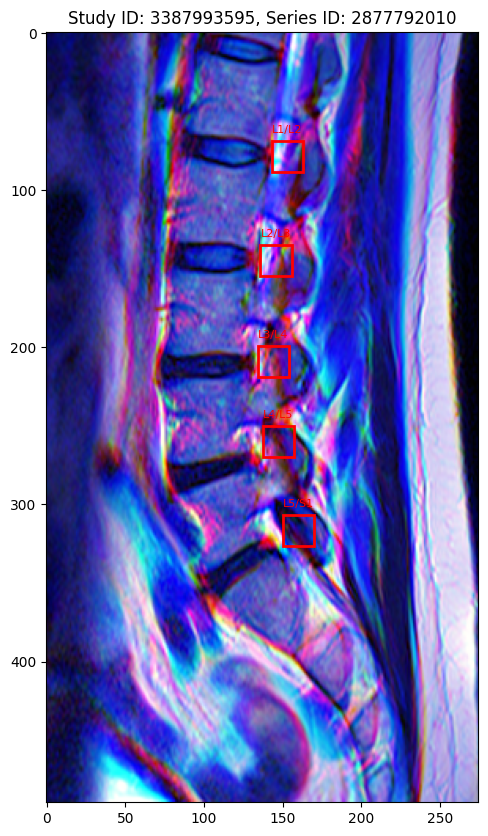

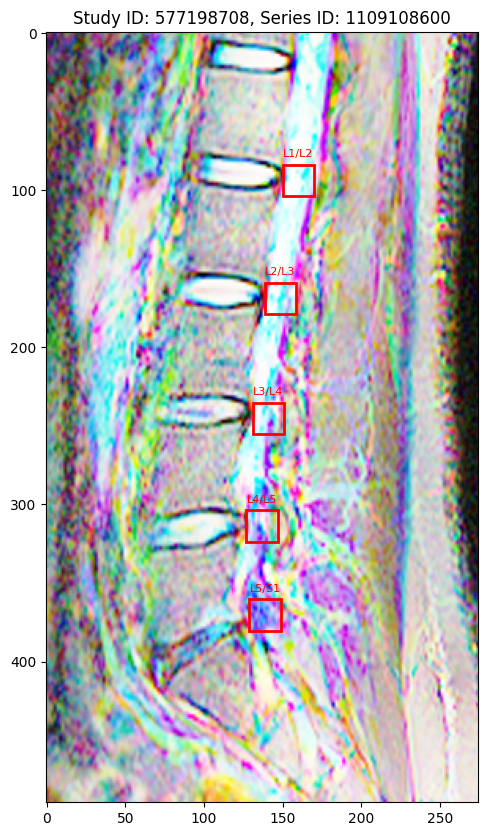

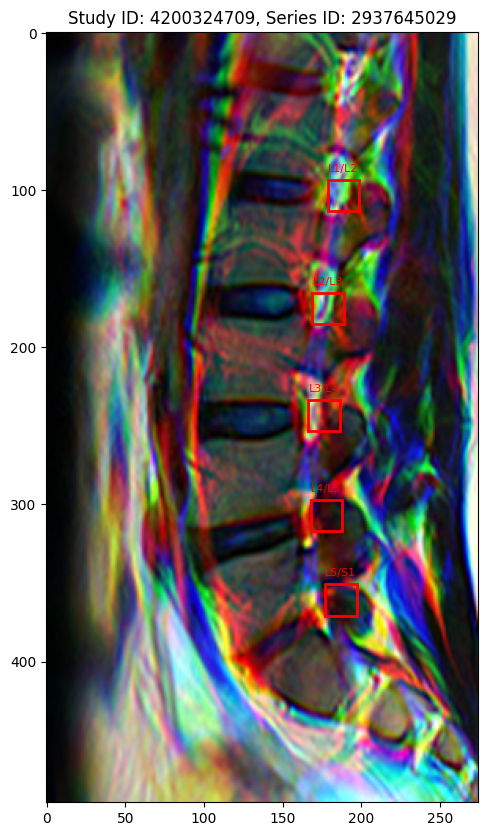

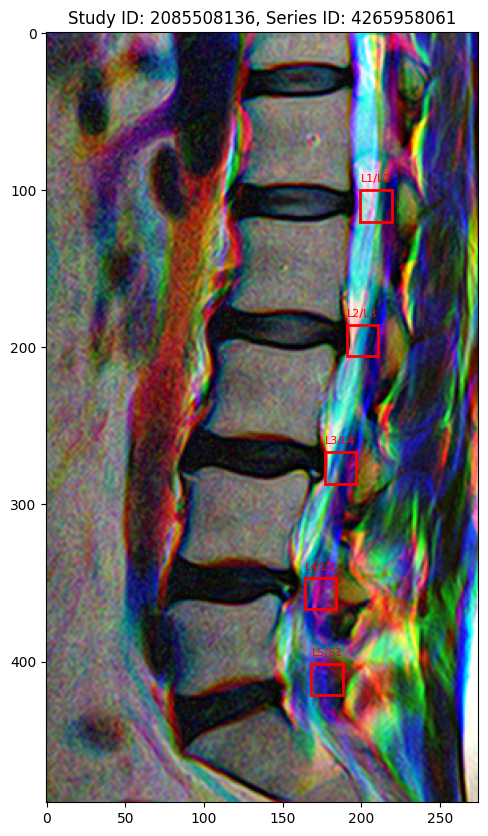

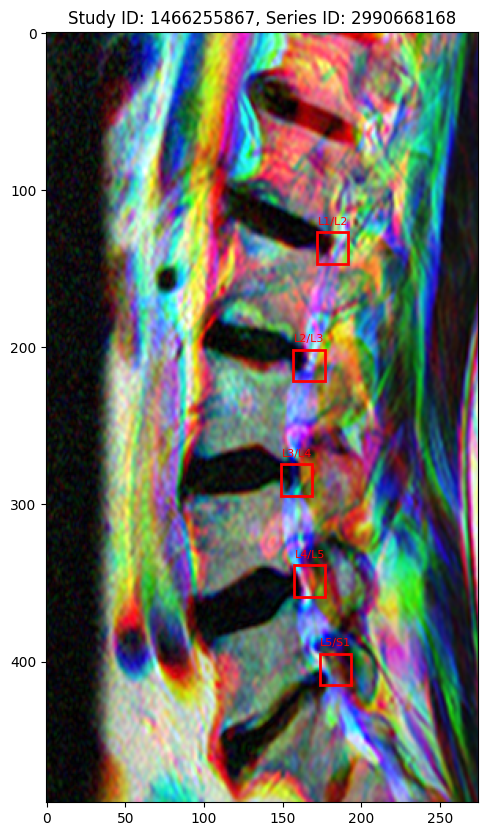

In [19]:
import random
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image

def test_load_sagittal_t2(num_samples=5):
    # Get unique study/series combinations
    unique_combinations = sagittal_t2_coordinates[['study_id', 'series_id']].drop_duplicates()
    
    # Randomly sample 5 combinations
    samples = unique_combinations.sample(n=num_samples, random_state=49)
    
    for _, row in samples.iterrows():
        study_id, series_id = row['study_id'], row['series_id']
        
        # Process the images
        load_sagittal_t2(study_id, series_id)
        
        # Load the saved image
        image_path = f'/kaggle/working/Converted_images/{study_id}/Sagittal_T2/multichannel.png'
        image = Image.open(image_path)
        
        # Get the updated coordinates
        updated_coords = new_sagittal_t2_coordinates[
            (new_sagittal_t2_coordinates['study_id'] == study_id) & 
            (new_sagittal_t2_coordinates['series_id'] == series_id)
        ]
        
        # Plot the image and coordinates
        fig, ax = plt.subplots(figsize=(10, 10))
        ax.imshow(image)
        ax.set_title(f"Study ID: {study_id}, Series ID: {series_id}")
        
        for _, coord in updated_coords.iterrows():
            rect = patches.Rectangle(
                (coord['x'] - 10, coord['y'] - 10),
                20, 20, linewidth=2, edgecolor='r', facecolor='none'
            )
            ax.add_patch(rect)
            ax.text(coord['x'], coord['y'] - 15, coord['level'], color='r', fontsize=8, ha='center')
        
        plt.show()

# Run the test
test_load_sagittal_t2(5)

### Would be nice to test with an image that does not have a label

### Currently coordinate change is not robust to scans having image sizes that vary 

# Sagittal T1


## Helper functions T1

In [20]:
CONDITIONS = ('Right Neural Foraminal Narrowing', 'Left Neural Foraminal Narrowing')

/opt/conda/lib/python3.10/site-packages/sklearn/model_selection/_split.py:700: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=5.
  warnings.warn(


Cross-validation RMSE: 1.58 (+/- 0.32)
Testing Best Ensemble Model for Sagittal T1:


Processing studies: 100%|██████████| 50/50 [01:17<00:00,  1.54s/it]


Root Mean Squared Error: 0.78
Custom Accuracy: 91.84%


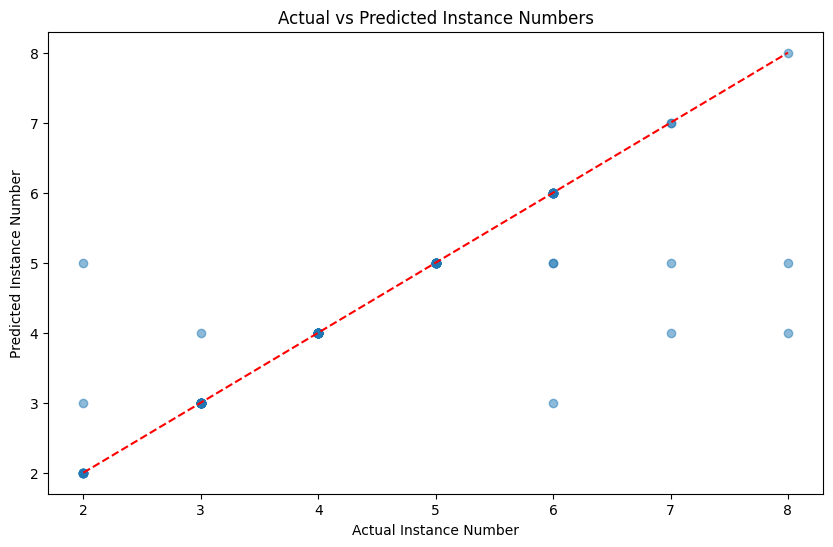

In [21]:
def collect_sagittal_t1_data():
    scan_features = []
    scan_labels = []
    
    grouped = sagittal_t1_coordinates.groupby(['study_id', 'series_id'])
    
    for (study_id, series_id), group in tqdm(grouped, desc="Collecting scan data"):
        image_paths = glob(f'{BASE_URL}/train_images/{study_id}/{series_id}/*.dcm')
        image_paths.sort(key=natural_keys)
        
        if len(image_paths) == 0:
            print(f"No images found for study {study_id}, series {series_id}")
            continue
        
        # Load and normalize images before cropping
        images = []
        for path in image_paths:
            img = pydicom.dcmread(path).pixel_array
            normalized = normalize_image(img)
            images.append(normalized)
        
        # Split images into right and left scans
        num_images = len(images)
        central_image_number = num_images // 2 + 1

        right_group = group.query('@central_image_number >= instance_number')
        left_group = group.query('@central_image_number < instance_number')

        if right_group.empty or left_group.empty:
            continue
        
        right_images = images[:central_image_number]
        left_images = images[central_image_number:][::-1]  # Reverse the left images
        
        # Process right images
        right_cropped_images, _ = crop_sagittal_images(right_images)
        right_normalized_images = [normalize_image(img) for img in right_cropped_images]
        right_normalized_images = preprocess_images(right_normalized_images)
        right_augmented_images = augment_scan(right_normalized_images)
        right_features = extract_advanced_features(right_augmented_images)
        right_labeled_instance = right_group['instance_number'].iloc[0] - 1
        
        scan_features.append(right_features)
        scan_labels.append(right_labeled_instance)
        
        # Process left images
        left_cropped_images, _ = crop_sagittal_images(left_images)
        left_normalized_images = [normalize_image(img) for img in left_cropped_images]
        left_normalized_images = preprocess_images(left_normalized_images)
        left_augmented_images = augment_scan(left_normalized_images)
        left_features = extract_advanced_features(left_augmented_images)
        left_labeled_instance = num_images - left_group['instance_number'].iloc[0]
        
        scan_features.append(left_features)
        scan_labels.append(left_labeled_instance)
    
    return np.array(scan_features), np.array(scan_labels)

# Collect scan-level data for Sagittal T1
scan_features_t1, scan_labels_t1 = collect_sagittal_t1_data()

# Feature scaling
scaler_t1 = StandardScaler()
scaled_features_t1 = scaler_t1.fit_transform(scan_features_t1)

# Dimensionality reduction
pca_t1 = PCA(n_components=0.95)  # Retain 95% of variance
reduced_features_t1 = pca_t1.fit_transform(scaled_features_t1)

best_params = {
    'gb__learning_rate': 0.047268686709404935, 
    'gb__n_estimators': 322, 
    'mlp__alpha': 0.008542131407263114, 
    'mlp__hidden_layer_sizes': (94, 15), 
    'rf__max_depth': 12, 
    'rf__n_estimators': 459, 
    'svm__C': 0.804161308495439, 
    'svm__kernel': 'rbf'
}

# Create the best model for Sagittal T1
best_model_t1 = create_best_ensemble_model(best_params)

# Perform cross-validation
cv_scores_t1 = cross_val_score(best_model_t1, reduced_features_t1, scan_labels_t1, cv=5, scoring='neg_mean_squared_error', n_jobs=-1)
print(f"Cross-validation RMSE: {np.sqrt(-cv_scores_t1.mean()):.2f} (+/- {np.sqrt(cv_scores_t1.std() * 2):.2f})")

# Train the model on the entire dataset
best_model_t1.fit(reduced_features_t1, scan_labels_t1)

# Save the trained model
joblib.dump(best_model_t1, 'Models/sagittal_t1_model.joblib')

# Update the prediction function for Sagittal T1
def predict_instance_number_sagittal_t1(scan_images):
    features = extract_advanced_features(scan_images)
    features = features.reshape(1, -1)
    features = scaler_t1.transform(features)
    reduced_features = pca_t1.transform(features)
    return best_model_t1.predict(reduced_features)[0]

# Test function for Sagittal T1
def test_find_instance_number_sagittal_t1(num_samples=50, model=best_model_t1):
    random.seed(42)
    unique_studies = sagittal_t1_coordinates['study_id'].unique()
    sampled_studies = random.sample(list(unique_studies), min(num_samples, len(unique_studies)))
    
    actual_instances = []
    predicted_instances = []
    
    for study_id in tqdm(sampled_studies, desc="Processing studies"):
        study_df = sagittal_t1_coordinates[sagittal_t1_coordinates['study_id'] == study_id]
        series_ids = study_df['series_id'].unique()
        
        for series_id in series_ids:
            series_df = study_df[study_df['series_id'] == series_id]
            
            image_paths = glob(f'{BASE_URL}/train_images/{study_id}/{series_id}/*.dcm')
            image_paths.sort(key=natural_keys)
            
            # Load and normalize images before cropping
            images = []
            for path in image_paths:
                img = pydicom.dcmread(path).pixel_array
                normalized = normalize_image(img)
                images.append(normalized)
            
            # Split images into right and left scans
            num_images = len(images)
            central_image_number = num_images // 2 + 1

            right_series_df = series_df[series_df['instance_number'] <= central_image_number]
            left_series_df = series_df[series_df['instance_number'] > central_image_number]

            if right_series_df.empty or left_series_df.empty:
                continue
            
            right_images = images[:central_image_number]
            left_images = images[central_image_number:][::-1]  # Reverse the left images
            
            # Process right images
            right_cropped_images, _ = crop_sagittal_images(right_images)
            right_normalized_images = [normalize_image(img) for img in right_cropped_images]
            right_normalized_images = preprocess_images(right_normalized_images)
            right_augmented_images = augment_scan(right_normalized_images)
            right_actual_instance = right_series_df['instance_number'].iloc[0] - 1
            right_predicted_instance = predict_instance_number_sagittal_t1(right_augmented_images)
            
            actual_instances.append(right_actual_instance)
            predicted_instances.append(right_predicted_instance)
            
            # Process left images
            left_cropped_images, _ = crop_sagittal_images(left_images)
            left_normalized_images = [normalize_image(img) for img in left_cropped_images]
            left_normalized_images = preprocess_images(left_normalized_images)
            left_augmented_images = augment_scan(left_normalized_images)
            left_actual_instance = num_images - left_series_df['instance_number'].iloc[0]
            left_predicted_instance = predict_instance_number_sagittal_t1(left_augmented_images)
            
            actual_instances.append(left_actual_instance)
            predicted_instances.append(left_predicted_instance)
    
    rmse = np.sqrt(mean_squared_error(np.array(actual_instances), np.array(predicted_instances)))
    custom_acc = custom_accuracy(np.array(actual_instances), np.array(predicted_instances))
    
    print(f"Root Mean Squared Error: {rmse:.2f}")
    print(f"Custom Accuracy: {custom_acc:.2%}")
    
    plt.figure(figsize=(10, 6))
    plt.scatter(actual_instances, predicted_instances, alpha=0.5)
    plt.plot([min(actual_instances), max(actual_instances)], [min(actual_instances), max(actual_instances)], 'r--')
    plt.xlabel("Actual Instance Number")
    plt.ylabel("Predicted Instance Number")
    plt.title("Actual vs Predicted Instance Numbers")
    plt.show()

# Run the test for Sagittal T1
print("Testing Best Ensemble Model for Sagittal T1:")
test_find_instance_number_sagittal_t1(model=best_model_t1)

In [22]:
def find_frame_number_sagittal_t1(images, side):
    """
    Predict the instance number for a given side scan in Sagittal T1.
    
    Args:
    images (list): List of numpy arrays representing the images in the scan.
    side (str): Either 'right' or 'left' to indicate which side of the scan.
    
    Returns:
    int: Predicted instance number for the given side scan.
    """
    # Ensure images are in the correct order
    if side == 'left':
        images = images[::-1]  # Reverse the left images
    
    preprocessed_images = preprocess_images(images)
    
    # Augment the scan
    augmented_images = augment_scan(preprocessed_images)
    
    # Extract features
    features = extract_advanced_features(augmented_images)
    features = features.reshape(1, -1)
    
    # Scale features
    scaled_features = scaler_t1.transform(features)
    
    # Reduce dimensionality
    reduced_features = pca_t1.transform(scaled_features)
    
    # Predict instance number
    predicted_instance = best_model_t1.predict(reduced_features)[0]
    
    # Round to nearest integer
    return round(predicted_instance) if side == 'right' else 2 * len(images) - round(predicted_instance)

## Main function T1

In [23]:
def load_sagittal_t1(study_id: int) -> None:
    """
    Load and process Sagittal T1 images for a given study.
    """
    logging.info(f"Processing Sagittal T1 for study ID: {study_id}")

    # Get all Sagittal T1 series for this study
    series_ids = train_descriptions[(train_descriptions['study_id'] == study_id) & 
                                    (train_descriptions['series_description'] == 'Sagittal T1')]['series_id']
    
    if series_ids.empty:
        logging.warning(f"No Sagittal T1 series found for study ID: {study_id}")
        return

    # If multiple series, choose the one with the most coordinates
    if len(series_ids) > 1:
        series_id = sagittal_t1_coordinates[
            (sagittal_t1_coordinates['study_id'] == study_id) & 
            (sagittal_t1_coordinates['series_id'].isin(series_ids))
        ]['series_id'].value_counts().index[0]
    else:
        series_id = series_ids.iloc[0]

    image_paths = glob(f'{BASE_URL}/train_images/{study_id}/{series_id}/*.dcm')
    image_paths.sort(key=natural_keys)
    
    if len(image_paths) < NUM_IMAGES_SAGITTAL_T1 * 2:
        logging.warning(f'Study ID: {study_id} does not have enough images')
        return

    try:
        first_image = pydicom.dcmread(image_paths[0])
        last_image = pydicom.dcmread(image_paths[-1])
    except Exception as e:
        logging.error(f"Error reading DICOM files for study ID: {study_id}. Error: {str(e)}")
        return

    image_paths, inverted = order_image_paths_sagittal_t1(image_paths, first_image, last_image)
    flipped = get_flip_status_sagittal_t1(first_image)
    
    num_images = len(image_paths)
    central_image_number = num_images // 2 + 1

    coordinate_entries = sagittal_t1_coordinates.query('@study_id == study_id and @series_id == series_id')
    has_coordinates, coordinate_entries_dict = process_coordinate_entries_sagittal_t1(coordinate_entries, central_image_number, inverted)

    if any(has_coordinates.values()):
        assert_correct_series_description_sagittal_t1(coordinate_entries)

    series_df_dict = get_series_dataframes_sagittal_t1(study_id, series_id)

    images_dict = {}
    start_coordinates_dict = {}
    instance_numbers_dict = {}

    for side in ['right', 'left']:
        image_slice = image_paths[:central_image_number+1] if side == 'right' else image_paths[central_image_number:]
        images, original_shape = process_images_sagittal_t1(image_slice, flipped)
        images, start_coordinates = crop_sagittal_images(images)
        images = [normalize_image(image) for image in images]
        instance_number = get_relative_instance_number_sagittal_t1(has_coordinates, coordinate_entries_dict, images, num_images, inverted, side)
        if instance_number < 0 or instance_number >= len(images):
            raise ValueError(f"Instance number {instance_number} is out of range for images with length {len(images)}")
        
        images_dict[side] = select_closest_images(images, instance_number, NUM_IMAGES_SAGITTAL_T1, preferred_direction='center')
        start_coordinates_dict[side] = start_coordinates
        instance_numbers_dict[side] = instance_number

        if has_coordinates[side]:
            update_coordinates_sagittal_t1(series_df_dict[side], start_coordinates_dict[side], images_dict[side], study_id, series_id, CONDITIONS[side == 'left'], flipped, original_shape)

    save_multichannel_image_sagittal_t1(study_id, images_dict)

def order_image_paths_sagittal_t1(image_paths: List[str], first_image: pydicom.dataset.FileDataset, last_image: pydicom.dataset.FileDataset) -> Tuple[List[str], bool]:
    x_first_image = first_image.ImagePositionPatient[0]
    x_last_image = last_image.ImagePositionPatient[0]
    inverted = x_first_image > x_last_image
    return image_paths[::-1] if inverted else image_paths, inverted

def get_flip_status_sagittal_t1(image: pydicom.dataset.FileDataset) -> List[bool]:
    return [image.ImageOrientationPatient[1] < 0, image.ImageOrientationPatient[5] > 0]

def process_coordinate_entries_sagittal_t1(coordinate_entries, central_image_number: int, inverted: bool) -> Tuple[Dict[str, bool], Dict[str, pd.DataFrame]]:
    has_coordinates = {'right': False, 'left': False}
    coordinate_entries_dict = {'right': None, 'left': None}
    
    if not coordinate_entries.empty:
        if inverted:
            coordinate_entries_dict['right'] = coordinate_entries.query('@central_image_number < instance_number')
            coordinate_entries_dict['left'] = coordinate_entries.query('@central_image_number > instance_number')
        else: 
            coordinate_entries_dict['right'] = coordinate_entries.query('@central_image_number > instance_number')
            coordinate_entries_dict['left'] = coordinate_entries.query('@central_image_number < instance_number')
        
        has_coordinates['right'] = not coordinate_entries_dict['right'].empty
        has_coordinates['left'] = not coordinate_entries_dict['left'].empty
    
    return has_coordinates, coordinate_entries_dict

def assert_correct_series_description_sagittal_t1(coordinate_entries):
    assert coordinate_entries['series_description'].unique()[0] == 'Sagittal T1'
    assert are_all_entries_same(coordinate_entries['series_description'])

def get_series_dataframes_sagittal_t1(study_id: int, series_id: int) -> Dict[str, pd.DataFrame]:
    return {
        'right': sagittal_t1_coordinates.query('@study_id == study_id and @series_id == series_id and @CONDITIONS[0] == condition'),
        'left': sagittal_t1_coordinates.query('@study_id == study_id and @series_id == series_id and @CONDITIONS[1] == condition')
    }

def process_images_sagittal_t1(image_paths: List[str], flipped: List[bool]) -> Tuple[List[np.ndarray], Tuple[int, int]]:
    images = []
    for path in image_paths:
        dcm = pydicom.dcmread(path)
        image = dcm.pixel_array
        normalized = normalize_image(image)
        images.append(normalized)
    
    original_shape = images[0].shape
    
    if flipped[0]:
        images = [np.fliplr(image) for image in images]
    if flipped[1]:
        images = [np.flipud(image) for image in images]
    
    return images, original_shape

def get_relative_instance_number_sagittal_t1(has_coordinates: Dict[str, bool], coordinate_entries: Dict[str, pd.DataFrame], images: List[np.ndarray], num_images: int, inverted: bool, side: str) -> int:
    if has_coordinates[side]:
        if side == 'right':
            if inverted:
                instance_number = num_images - coordinate_entries[side]['instance_number'].max()
            else:
                instance_number = coordinate_entries[side]['instance_number'].min() - 1
        else:
            if inverted:
                instance_number = coordinate_entries[side]['instance_number'].min() - 1
            else:
                instance_number = num_images - coordinate_entries[side]['instance_number'].max()
        
        if 0 <= instance_number < len(images):
            return instance_number
        else:
            return min(find_frame_number_sagittal_t1(images, side), len(images) - 1)
    else:
        return min(find_frame_number_sagittal_t1(images, side), len(images) - 1)

def update_coordinates_sagittal_t1(series_df: pd.DataFrame, start_coordinates: Tuple[int, int], images: List[np.ndarray], 
                       study_id: int, series_id: int, condition: str, flipped: List[bool], original_shape: Tuple[int, int]) -> None:
    x_distortion = SAGITTAL_IMAGE_SHAPE[1] / images[0].shape[1]
    y_distortion = SAGITTAL_IMAGE_SHAPE[0] / images[0].shape[0]

    for level in LEVELS:
        try:
            x = series_df.loc[series_df['level'] == level, 'x']
            y = series_df.loc[series_df['level'] == level, 'y']

            # Adjust for flipping
            if flipped[0]:  # flipped horizontally
                x = original_shape[1] - x
            if flipped[1]:  # flipped vertically
                y = original_shape[0] - y

            # Adjust for cropping and resizing
            series_df.loc[series_df['level'] == level, 'x'] = (x - start_coordinates[0]) * x_distortion
            series_df.loc[series_df['level'] == level, 'y'] = (y - start_coordinates[1]) * y_distortion

        except Exception as e:
            logging.warning(f"Error updating coordinates for level {level}: {str(e)}")

    new_sagittal_t1_coordinates.loc[
        (new_sagittal_t1_coordinates['study_id'] == study_id) & 
        (new_sagittal_t1_coordinates['series_id'] == series_id) & 
        (new_sagittal_t1_coordinates['condition'] == condition)
    ] = series_df

def save_multichannel_image_sagittal_t1(study_id: int, images_dict: Dict[str, List[np.ndarray]]) -> None:
    base_destination_url = f'Converted_images/{study_id}/Sagittal_T1/'
    os.makedirs(base_destination_url, exist_ok=True)

    # Ensure we have exactly 3 images for RGB channels
    right_images = images_dict['right'][:3]
    left_images = images_dict['left'][:3]
    
    while len(right_images) < 3:
        right_images.append(np.zeros_like(right_images[0]))
    while len(left_images) < 3:
        left_images.append(np.zeros_like(left_images[0]))

    # Resize images
    right_resized = [cv2.resize(img, SAGITTAL_IMAGE_SHAPE[::-1], interpolation=cv2.INTER_CUBIC) for img in right_images]
    left_resized = [cv2.resize(img, SAGITTAL_IMAGE_SHAPE[::-1], interpolation=cv2.INTER_CUBIC) for img in left_images]

    # Create 3-channel images
    right_multichannel = np.stack(right_resized, axis=-1)
    left_multichannel = np.stack(left_resized, axis=-1)

    # Save the images
    cv2.imwrite(f'{base_destination_url}right.png', right_multichannel)
    cv2.imwrite(f'{base_destination_url}left.png', left_multichannel)

## Testing T1

Processing study ID: 1722603252


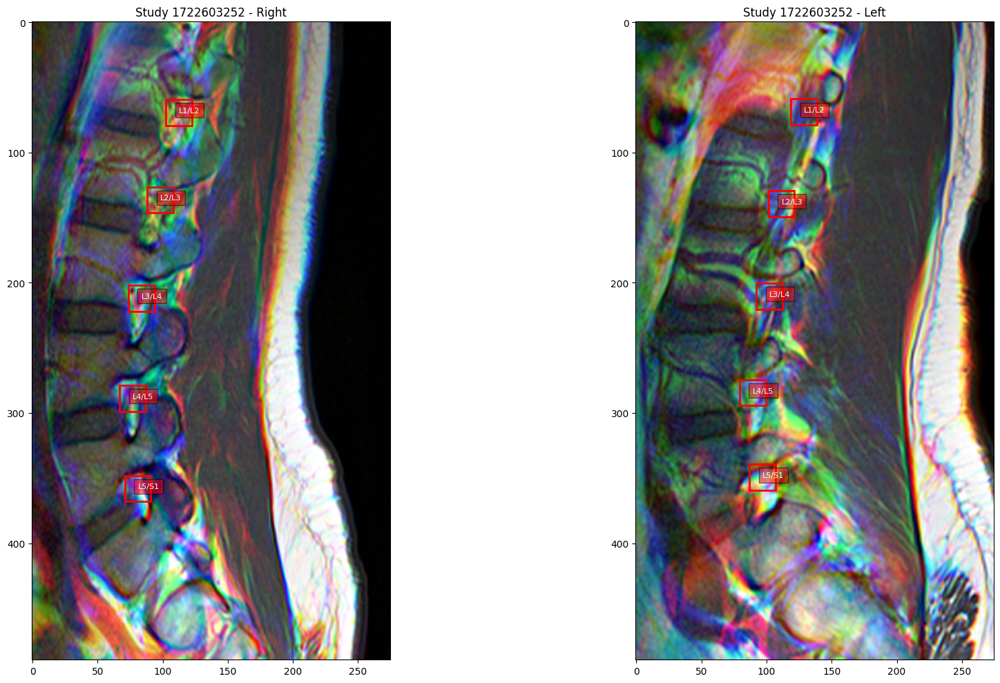

Coordinates for study 1722603252:
                              condition  level           x           y
19203  Right Neural Foraminal Narrowing  L3/L4   83.700980  211.844833
19204  Right Neural Foraminal Narrowing  L4/L5   77.003301  288.723719
19205  Right Neural Foraminal Narrowing  L5/S1   80.844838  358.087060
19206  Right Neural Foraminal Narrowing  L1/L2  112.537515   69.262659
19207  Right Neural Foraminal Narrowing  L2/L3   98.131753  136.351792
19208   Left Neural Foraminal Narrowing  L1/L2  128.779513   68.882679
19209   Left Neural Foraminal Narrowing  L2/L3  111.374749  139.190298
19210   Left Neural Foraminal Narrowing  L3/L4  102.294002  210.262130
19211   Left Neural Foraminal Narrowing  L4/L5   89.429612  284.390814
19212   Left Neural Foraminal Narrowing  L5/S1   96.996900  349.348940


Processing study ID: 425970461


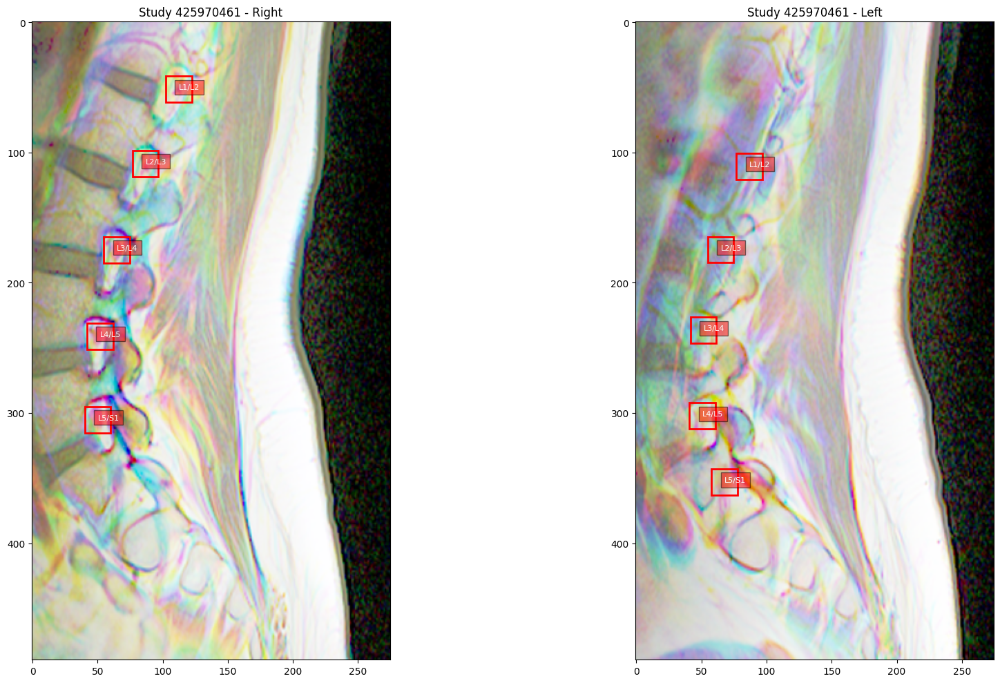

Coordinates for study 425970461:
                             condition  level           x           y
4904  Right Neural Foraminal Narrowing  L3/L4   64.747116  174.773865
4905  Right Neural Foraminal Narrowing  L4/L5   51.958189  241.111171
4906  Right Neural Foraminal Narrowing  L5/S1   50.131200  305.285304
4907  Right Neural Foraminal Narrowing  L1/L2  112.248847   51.473002
4908  Right Neural Foraminal Narrowing  L2/L3   86.670992  108.436559
4909   Left Neural Foraminal Narrowing  L1/L2   86.804602  110.631283
4910   Left Neural Foraminal Narrowing  L2/L3   64.757791  174.638824
4911   Left Neural Foraminal Narrowing  L3/L4   51.469301  236.500861
4912   Left Neural Foraminal Narrowing  L4/L5   50.865279  302.296322
4913   Left Neural Foraminal Narrowing  L5/S1   67.777902  353.073254


Processing study ID: 1639920408


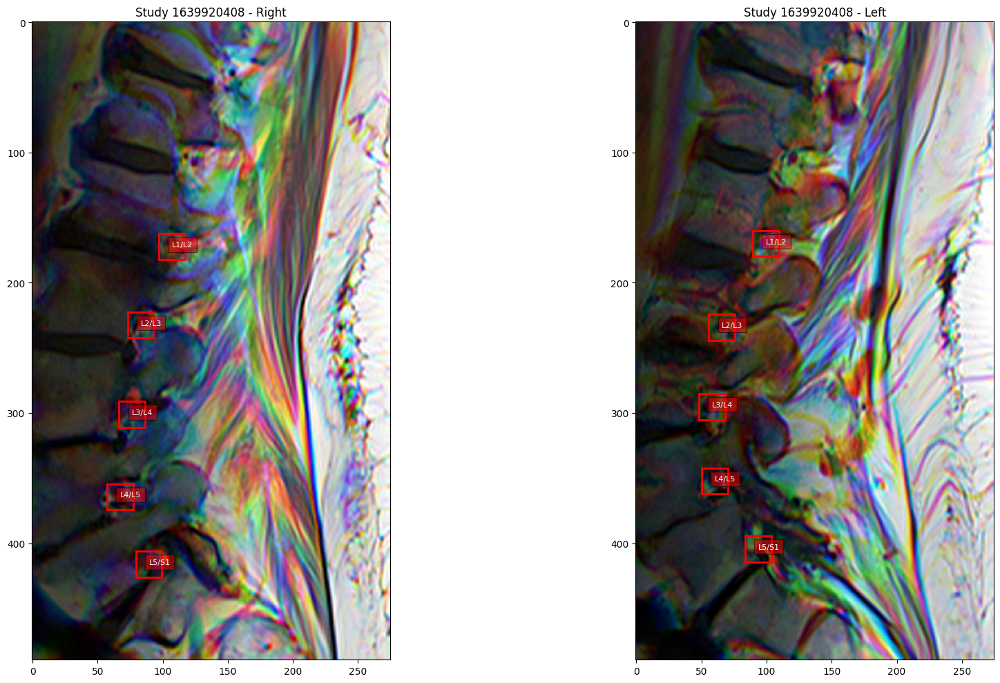

Coordinates for study 1639920408:
                              condition  level           x           y
18143  Right Neural Foraminal Narrowing  L5/S1   89.404826  416.175091
18144  Right Neural Foraminal Narrowing  L1/L2  106.982622  172.239392
18145  Right Neural Foraminal Narrowing  L2/L3   82.928795  232.433357
18146  Right Neural Foraminal Narrowing  L3/L4   76.452765  301.075599
18147  Right Neural Foraminal Narrowing  L4/L5   67.201293  364.437668
18148   Left Neural Foraminal Narrowing  L1/L2   99.344138  169.897820
18149   Left Neural Foraminal Narrowing  L2/L3   65.716173  234.151907
18150   Left Neural Foraminal Narrowing  L3/L4   57.943767  295.190972
18151   Left Neural Foraminal Narrowing  L4/L5   60.179539  352.187500
18152   Left Neural Foraminal Narrowing  L5/S1   93.495797  404.383515


Processing study ID: 3772850329


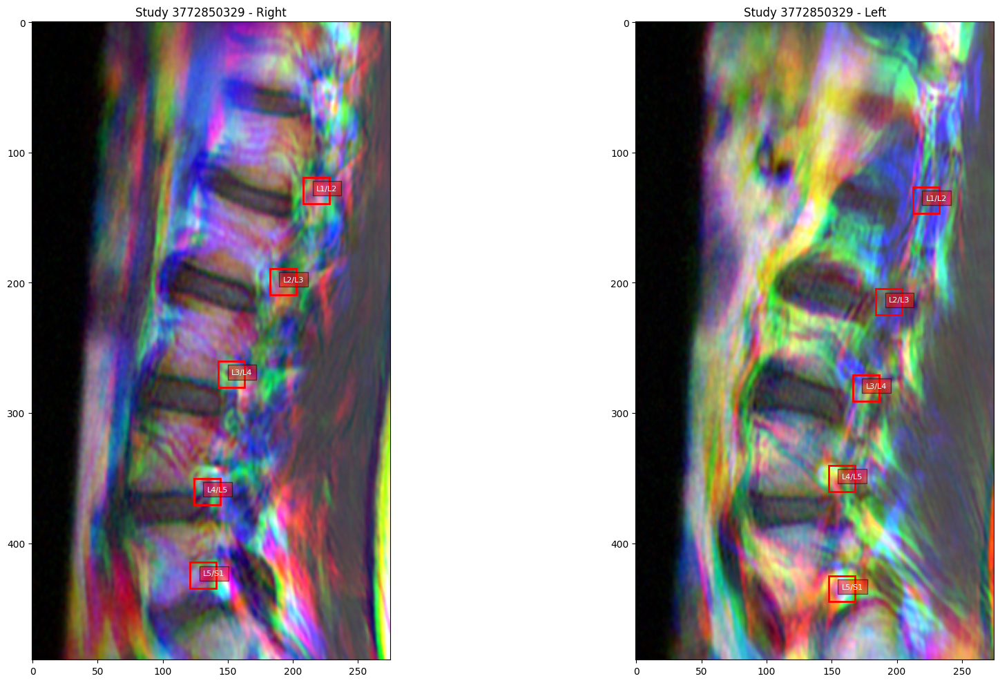

Coordinates for study 3772850329:
                              condition  level           x           y
42824   Left Neural Foraminal Narrowing  L1/L2  222.442174  136.574866
42825   Left Neural Foraminal Narrowing  L2/L3  194.028607  214.763907
42826   Left Neural Foraminal Narrowing  L3/L4  176.392600  280.839153
42827   Left Neural Foraminal Narrowing  L4/L5  157.776815  350.218161
42828   Left Neural Foraminal Narrowing  L5/S1  157.776815  435.014727
42829  Right Neural Foraminal Narrowing  L1/L2  218.113836  129.197761
42830  Right Neural Foraminal Narrowing  L2/L3  192.408859  199.205202
42831  Right Neural Foraminal Narrowing  L3/L4  152.862740  270.323872
42832  Right Neural Foraminal Narrowing  L4/L5  134.078334  360.333440
42833  Right Neural Foraminal Narrowing  L5/S1  131.112375  424.784735


Processing study ID: 1546157543


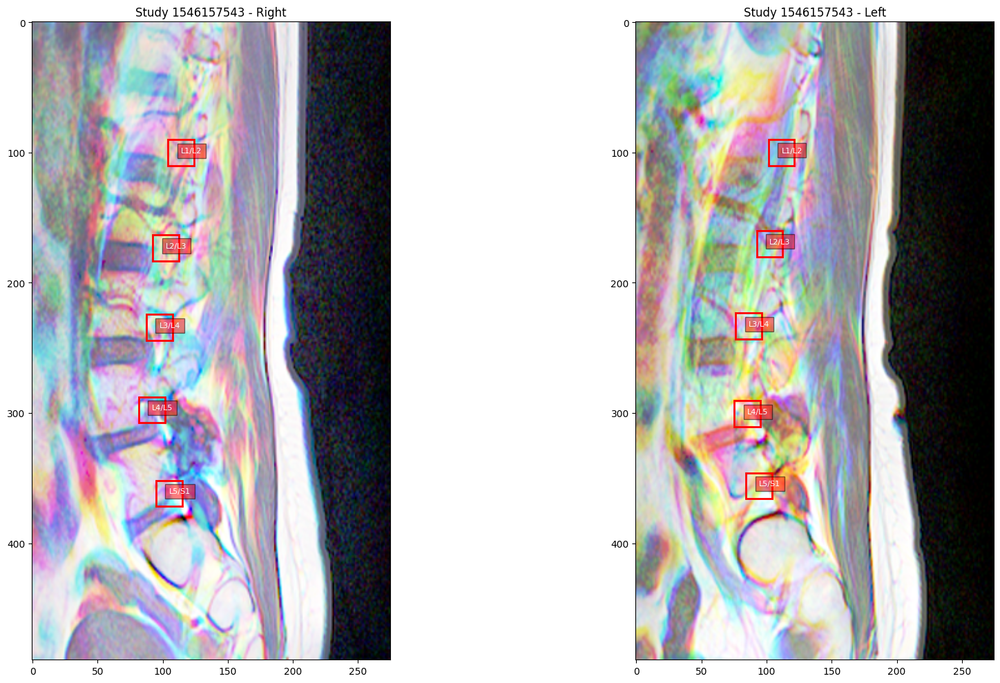

Coordinates for study 1546157543:
                              condition  level           x           y
17398  Right Neural Foraminal Narrowing  L5/S1  104.990764  361.765252
17399  Right Neural Foraminal Narrowing  L2/L3  102.490054  173.256857
17400  Right Neural Foraminal Narrowing  L3/L4   97.488633  234.448064
17401  Right Neural Foraminal Narrowing  L4/L5   91.653642  297.613180
17402  Right Neural Foraminal Narrowing  L1/L2  114.160036  100.222191
17403   Left Neural Foraminal Narrowing  L1/L2  111.439884   99.981959
17404   Left Neural Foraminal Narrowing  L2/L3  102.338397  170.027562
17405   Left Neural Foraminal Narrowing  L3/L4   86.410795  233.338011
17406   Left Neural Foraminal Narrowing  L4/L5   85.273109  300.689551
17407   Left Neural Foraminal Narrowing  L5/S1   94.374596  355.917815




In [24]:
def test_load_sagittal_t1(num_studies = 5):
    # Get all unique study IDs with Sagittal T1 series
    sagittal_t1_studies = train_descriptions[train_descriptions['series_description'] == 'Sagittal T1']['study_id'].unique()
    
    # Randomly select 5 studies
    selected_studies = random.sample(list(sagittal_t1_studies), num_studies)
    
    for study_id in selected_studies:
        print(f"Processing study ID: {study_id}")
        
        # Process the study
        load_sagittal_t1(study_id)
        
        # Load the processed images
        right_image_path = f'/kaggle/working/Converted_images/{study_id}/Sagittal_T1/right.png'
        left_image_path = f'/kaggle/working/Converted_images/{study_id}/Sagittal_T1/left.png'
        
        right_image = cv2.imread(right_image_path)
        left_image = cv2.imread(left_image_path)
        
        # Get the coordinates for this study
        study_coords = new_sagittal_t1_coordinates[new_sagittal_t1_coordinates['study_id'] == study_id]
        
        # Plot the images and coordinates
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
        
        ax1.imshow(cv2.cvtColor(right_image, cv2.COLOR_BGR2RGB))
        ax1.set_title(f"Study {study_id} - Right")
        ax2.imshow(cv2.cvtColor(left_image, cv2.COLOR_BGR2RGB))
        ax2.set_title(f"Study {study_id} - Left")
        
        for condition, ax in zip(CONDITIONS, [ax1, ax2]):
            coords = study_coords[study_coords['condition'] == condition]
            for _, row in coords.iterrows():
                ax.text(row['x'], row['y'], row['level'], color='white', fontsize=8, 
                        bbox=dict(facecolor='red', alpha=0.5))
                
                # Add rectangle patch
                rect = patches.Rectangle((row['x']-10, row['y']-10), 20, 20, 
                                         linewidth=2, edgecolor='red', facecolor='none')
                ax.add_patch(rect)
        
        plt.tight_layout()
        plt.show()
        
        print(f"Coordinates for study {study_id}:")
        print(study_coords[['condition', 'level', 'x', 'y']])
        print("\n" + "="*50 + "\n")

# Run the test
test_load_sagittal_t1()

### Should we consider always saving the images in order: from outer to inner? So our model always gets the same?

# Axial T2

## Helper functions Axial

In [25]:
def crop_axial_images(images, flipped = [False, False]):
    ''' 
    Cropping Axial images based on robust statistical analysis on the label coordinates.
    Crop images and get the coordinates of the new top left corner 
    Could use optimisation
    Currently does not handle images of different size in the same scan well
    '''
    
    shape = images[0].shape
    
    x_start = round(shape[1] * AXIAL_START_X)
    x_end = round(shape[1] * AXIAL_END_X)
    y_start = round(shape[0] * AXIAL_START_Y)
    y_end = round(shape[0] * AXIAL_END_Y)
    
    return [[image[y_start: y_end, x_start: x_end] for image in images], (x_start, y_start)]

In [26]:
def detect_minima(smoothed_signal, prominence_threshold, min_distance):
    
    minima_indices, properties = find_peaks(-smoothed_signal, prominence=prominence_threshold, distance=min_distance)
    
    # detecting the minima at the boundary by reflection - find_peaks does not handle it automatically
    
    # Number of points to reflect
    n_reflect = np.min([minima_indices[0], len(smoothed_signal) - minima_indices[0], len(smoothed_signal) // 5])

    # Reflect the signal at both boundaries
    reflected_signal = np.concatenate((smoothed_signal[n_reflect:0:-1], smoothed_signal, smoothed_signal[-2:-n_reflect-2:-1]))

    # Detect minima in the extended signal by inverting it
    minima_indices_extended, properties = find_peaks(-reflected_signal, prominence=1)

    # Filter minima that are in the original signal range
    minima_indices = minima_indices_extended[
        (minima_indices_extended >= n_reflect) & 
        (minima_indices_extended < len(smoothed_signal) + n_reflect)
    ]

    # Adjust indices to correspond to the original signal
    minima_indices -= n_reflect
    
    return minima_indices

In [27]:
# study_id = 443364658 is very blurred which made me set sigma so small. I hope the noise in the others won't make me detect random things
def detect_instance_numbers_axial_t2(intensity_profile, min_distance = 5, prominence_threshold = 0.05, sigma = 0.1, plot = False):
    # to correct for noise, since sigma now is small
    if min_distance < 2:
        min_distance = 2
    
    smoothed_signal = gaussian_filter1d(intensity_profile, sigma=sigma)
    minima_indices = detect_minima(smoothed_signal, prominence_threshold, min_distance)
    
    # if the method has detected too many, apply smoothing and retry
    if len(minima_indices) > len(LEVELS):
        smoothed_signal = gaussian_filter1d(intensity_profile, sigma=0.45)
        minima_indices = detect_minima(smoothed_signal, prominence_threshold, min_distance)
        
    # if the method still detects too many, remove last if it coincides with the end
    if len(minima_indices) > len(LEVELS) and minima_indices[-1] == len(intensity_profile) - 1:
        minima_indices = minima_indices[:-1]
    
    # if the method still detects too many, remove first if it coincides with the start
    if len(minima_indices) > len(LEVELS) and minima_indices[0] == 0:
        minima_indices = minima_indices[1:]
    
    # if the length is still too great, pick last five
    if len(minima_indices) > len(LEVELS):
        minima_indices_selected = minima_indices[-5:]
    else:
        minima_indices_selected = minima_indices
    
    # plotting for debugging
    if plot:
        plt.figure(figsize=(10, 6))
        plt.plot(intensity_profile, label='Original Signal', alpha=0.5)
        plt.plot(smoothed_signal, label='Smoothed Signal', linewidth=2)
        plt.plot(minima_indices_selected, smoothed_signal[minima_indices_selected], "x", label='Detected Minima', markersize=10)
        plt.title('Detection of Intervertebral Regions')
        plt.xlabel('Slice Index')
        plt.ylabel('Median Intensity')
        plt.legend()
        plt.show()
    
    # If in the future we were interested in computing how many slides an intervetebral region has, we could use the following
    # peak_widths(x, peaks, rel_height=0.5)
    
    # checking that at least one intervetebral space was detected
    assert len(minima_indices_selected) >= 1
    assert len(minima_indices_selected) <= len(LEVELS)
    
    return minima_indices_selected

In [28]:
def extract_z_value(dicom):
    return dicom.ImagePositionPatient[2]

def extract_slice_thickness(dicom):
    return dicom.SliceThickness

Processing studies: 100%|██████████| 100/100 [02:24<00:00,  1.45s/it]


Overall Accuracy: 0.40

Per-level Accuracies:
L1/L2: 0.49
L2/L3: 0.54
L3/L4: 0.38
L4/L5: 0.31
L5/S1: 0.27


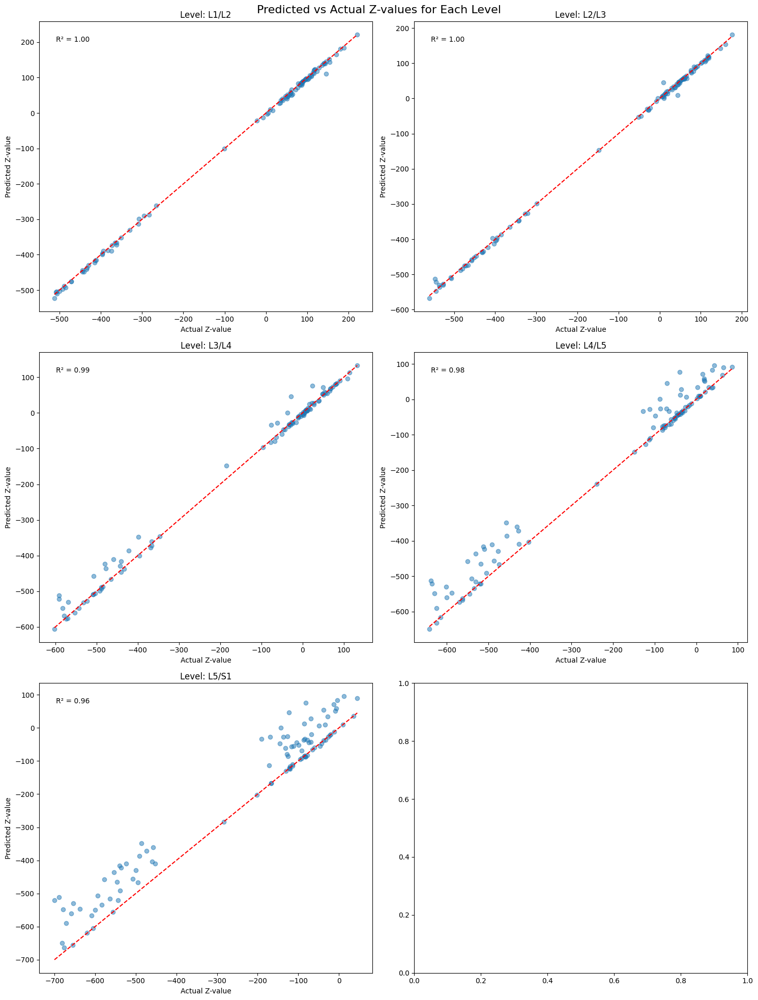

In [29]:
def test_intervertebral_detection(axial_t2_coordinates, train_descriptions, num_scans=100):
    study_ids = axial_t2_coordinates.groupby('study_id').filter(lambda x: len(x['level'].unique()) == 5)['study_id'].unique()
    np.random.shuffle(study_ids)
    study_ids = study_ids[:num_scans]
    
    correct_detections = 0
    total_detections = 0
    level_accuracies = defaultdict(lambda: {'correct': 0, 'total': 0})
    level_predictions = defaultdict(lambda: {'predicted': [], 'actual': []})
    
    for study_id in tqdm(study_ids, desc="Processing studies"):
        study_df = axial_t2_coordinates[axial_t2_coordinates['study_id'] == study_id]
        series_ids = train_descriptions[(train_descriptions['study_id'] == study_id) & 
                                        (train_descriptions['series_description'] == 'Axial T2')]['series_id']
        
        consolidated_scan = []
        z_values = []
        slice_thicknesses = []
        
        for series_id in series_ids:
            image_paths = glob(f'{BASE_URL}/train_images/{study_id}/{series_id}/*.dcm')
            image_paths.sort(key=natural_keys)
            
            for path in image_paths:
                try:
                    dcm = pydicom.dcmread(path)
                    slice_thicknesses.append(extract_slice_thickness(dcm))
                    z_value = extract_z_value(dcm)
                    
                    image = normalize_image(dcm.pixel_array)
                    if dcm.ImageOrientationPatient[0] < 0:
                        image = np.fliplr(image)
                    if dcm.ImageOrientationPatient[4] < 0:
                        image = np.flipud(image)
                    
                    consolidated_scan.append(image)
                    z_values.append(z_value)
                except Exception as e:
                    print(f"Error processing image {path}: {str(e)}")
        
        if not consolidated_scan:
            continue
        
        sorted_indices = np.argsort(z_values)
        consolidated_scan = [consolidated_scan[i] for i in sorted_indices]
        z_values = [z_values[i] for i in sorted_indices]
        
        min_slice_thickness = min(slice_thicknesses)
        filtered_scan = []
        filtered_z_values = []
        
        for i, (image, z_value) in enumerate(zip(consolidated_scan, z_values)):
            if not filtered_z_values or abs(z_value - filtered_z_values[-1]) >= min_slice_thickness / 2:
                filtered_scan.append(image)
                filtered_z_values.append(z_value)
        
        common_shape = (256, 256)
        processed_scan = []
        for image in filtered_scan:
            if not isinstance(image, np.ndarray):
                image = np.array(image)
            
            if image.ndim == 3:
                image = image[:,:,0]
            
            shape = image.shape
            x_start = round(shape[1] * AXIAL_START_X)
            x_end = round(shape[1] * AXIAL_END_X)
            y_start = round(shape[0] * AXIAL_START_Y)
            y_end = round(shape[0] * AXIAL_END_Y)
            cropped_image = image[y_start:y_end, x_start:x_end]
            
            resized = cv2.resize(cropped_image, common_shape, interpolation=cv2.INTER_CUBIC)
            
            normalized = normalize_image(resized)
            
            processed_scan.append(normalized)
        
        intensity_profile = [np.median(image) for image in processed_scan]
        
        detected_indices = detect_instance_numbers_axial_t2(intensity_profile)
        
        for level in LEVELS:
            level_df = study_df[study_df['level'] == level]
            if not level_df.empty:
                ground_truth_z = extract_z_value(pydicom.dcmread(f'{BASE_URL}/train_images/{study_id}/{level_df.iloc[0].series_id}/{level_df.iloc[0].instance_number}.dcm'))
                closest_detected_index = min(detected_indices, key=lambda x: abs(filtered_z_values[x] - ground_truth_z))
                
                level_predictions[level]['predicted'].append(filtered_z_values[closest_detected_index])
                level_predictions[level]['actual'].append(ground_truth_z)
                
                if abs(filtered_z_values[closest_detected_index] - ground_truth_z) <= min_slice_thickness:
                    correct_detections += 1
                    level_accuracies[level]['correct'] += 1
                
                total_detections += 1
                level_accuracies[level]['total'] += 1
    
    overall_accuracy = correct_detections / total_detections if total_detections > 0 else 0
    
    per_level_accuracies = {level: acc['correct'] / acc['total'] if acc['total'] > 0 else 0 
                            for level, acc in level_accuracies.items()}
    
    print(f"Overall Accuracy: {overall_accuracy:.2f}")
    print("\nPer-level Accuracies:")
    for level, accuracy in per_level_accuracies.items():
        print(f"{level}: {accuracy:.2f}")
    
    fig, axes = plt.subplots(3, 2, figsize=(15, 20))
    fig.suptitle("Predicted vs Actual Z-values for Each Level", fontsize=16)
    
    for i, level in enumerate(LEVELS):
        ax = axes[i // 2, i % 2]
        predicted = level_predictions[level]['predicted']
        actual = level_predictions[level]['actual']
        
        ax.scatter(actual, predicted, alpha=0.5)
        ax.plot([min(actual), max(actual)], [min(actual), max(actual)], 'r--')
        
        ax.set_title(f"Level: {level}")
        ax.set_xlabel("Actual Z-value")
        ax.set_ylabel("Predicted Z-value")
        
        correlation_matrix = np.corrcoef(actual, predicted)
        r_squared = correlation_matrix[0, 1]**2
        ax.text(0.05, 0.95, f'R² = {r_squared:.2f}', transform=ax.transAxes, verticalalignment='top')
    
    plt.tight_layout()
    plt.show()

# Usage
test_intervertebral_detection(axial_t2_coordinates, train_descriptions)

## Main function Axial

In [30]:
def load_axial_t2(study_id: int) -> None:
    series_description = 'Axial T2'
    
    study_coordinate_entries = axial_t2_coordinates.query('@study_id == study_id and @series_description == series_description')
    study_has_any_coordinate = not study_coordinate_entries.empty

    if study_has_any_coordinate:
        study_df = axial_t2_coordinates[(axial_t2_coordinates['study_id'] == study_id) & (axial_t2_coordinates['series_description'] == series_description)].copy()
        assert study_coordinate_entries['series_description'].unique()[0] == series_description
        assert are_all_entries_same(study_coordinate_entries['series_description'])
    else:
        study_df = pd.DataFrame(columns=axial_t2_coordinates.columns)
    
    series_ids = train_descriptions.query('@study_id == study_id and @series_description == series_description')['series_id']
    
    consolidated_scan = []
    z_values = []
    crop_coordinates = {}
    original_shapes = {}
    slice_thicknesses = []
    series_id_map = {}
    instance_number_map = {}
    series_lengths = {}
    
    for _, series_id in series_ids.items():
        image_paths = glob(f'{BASE_URL}/train_images/{study_id}/{series_id}/*.dcm')
        image_paths.sort(key=natural_keys)
        series_lengths[series_id] = len(image_paths)
        
        for path in image_paths:
            try:
                dcm = pydicom.dcmread(path)
                slice_thicknesses.append(extract_slice_thickness(dcm))
                z_value = extract_z_value(dcm)
                
                image = dcm.pixel_array
                if dcm.ImageOrientationPatient[0] < 0:
                    image = np.fliplr(image)
                if dcm.ImageOrientationPatient[4] < 0:
                    image = np.flipud(image)
                
                original_shapes[len(consolidated_scan)] = image.shape
                
                # Crop image
                shape = image.shape
                x_start = round(shape[1] * AXIAL_START_X)
                x_end = round(shape[1] * AXIAL_END_X)
                y_start = round(shape[0] * AXIAL_START_Y)
                y_end = round(shape[0] * AXIAL_END_Y)
                cropped_image = image[y_start:y_end, x_start:x_end]
                
                crop_coordinates[len(consolidated_scan)] = (x_start, y_start)

                cropped_image = normalize_image(cropped_image)
                
                consolidated_scan.append(cropped_image)
                z_values.append(z_value)
                series_id_map[len(consolidated_scan) - 1] = series_id
                instance_number_map[len(consolidated_scan) - 1] = dcm.InstanceNumber
            except Exception as e:
                print(f"Error processing image {path}: {str(e)}")
    
    # Check if instance numbers are valid
    invalid_series = set()
    for _, row in study_df.iterrows():
        if row['instance_number'] > series_lengths.get(row['series_id'], 0):
            invalid_series.add(row['series_id'])
    
    if invalid_series:
        print(f"Invalid instance numbers found for series: {invalid_series}")
        study_df = study_df[~study_df['series_id'].isin(invalid_series)]
        study_has_any_coordinate = not study_df.empty
    
    # Sort images by z-value
    sorted_indices = np.argsort(-np.array(z_values))
    consolidated_scan = [consolidated_scan[i] for i in sorted_indices]
    z_values = [z_values[i] for i in sorted_indices]
    crop_coordinates = {i: crop_coordinates[sorted_indices[i]] for i in range(len(sorted_indices))}
    original_shapes = {i: original_shapes[sorted_indices[i]] for i in range(len(sorted_indices))}
    series_id_map = {i: series_id_map[sorted_indices[i]] for i in range(len(sorted_indices))}
    instance_number_map = {i: instance_number_map[sorted_indices[i]] for i in range(len(sorted_indices))}
    
    # Filter out overlapping images
    min_slice_thickness = min(slice_thicknesses)
    filtered_scan = []
    filtered_z_values = []
    filtered_crop_coordinates = {}
    filtered_original_shapes = {}
    filtered_series_id_map = {}
    filtered_instance_number_map = {}
    
    for i, (image, z_value) in enumerate(zip(consolidated_scan, z_values)):
        if not filtered_z_values or abs(z_value - filtered_z_values[-1]) >= min_slice_thickness / 2:
            filtered_scan.append(image)
            filtered_z_values.append(z_value)
            filtered_crop_coordinates[len(filtered_scan) - 1] = crop_coordinates[i]
            filtered_original_shapes[len(filtered_scan) - 1] = original_shapes[i]
            filtered_series_id_map[len(filtered_scan) - 1] = series_id_map[i]
            filtered_instance_number_map[len(filtered_scan) - 1] = instance_number_map[i]
    
    # Initialize level_instances with the given coordinates
    level_instances = {level: None for level in LEVELS}
    level_z_values = {level: [] for level in LEVELS}

    # First pass: collect all z-values for each level
    for _, row in study_df.iterrows():
        level = row['level']
        instance_number = row['instance_number']
        series_id = row['series_id']
        
        # Find the index and z-value in filtered_scan that corresponds to this instance number and series_id
        for i, (s_id, inst_num) in enumerate(zip(filtered_series_id_map.values(), filtered_instance_number_map.values())):
            if s_id == series_id and inst_num == instance_number:
                z_value = filtered_z_values[i]
                level_z_values[level].append((z_value, i))
                break

    # Second pass: select the median z-value for each level
    for level in LEVELS:
        if level_z_values[level]:
            # Sort by z-value
            sorted_z_values = sorted(level_z_values[level])
            # Select the median
            median_index = len(sorted_z_values) // 2
            median_z_value, median_i = sorted_z_values[median_index]
            level_instances[level] = median_i

    # Remove the temporary level_z_values dictionary
    del level_z_values

    # Use find_instance_number to detect peaks for missing levels
    if any(instance is None for instance in level_instances.values()):
        intensity_profile = [np.median(image) for image in filtered_scan]
        detected_indices = detect_instance_numbers_axial_t2(intensity_profile, len(filtered_scan))
        
        # Fill in missing levels
        previous_z_value = float('-inf')  # Initialize with a low value
        for level, instance in zip(reversed(LEVELS), reversed(detected_indices)):
            if level_instances[level] is None:
                current_z_value = filtered_z_values[instance]
                if current_z_value > previous_z_value:
                    level_instances[level] = instance
                    previous_z_value = current_z_value
                else:
                    # Find the next available instance with a higher z-value
                    for alt_instance in range(instance, len(filtered_z_values)):
                        alt_z_value = filtered_z_values[alt_instance]
                        if alt_z_value > previous_z_value:
                            level_instances[level] = alt_instance
                            previous_z_value = alt_z_value
                            break
            else:
                # Update previous_z_value if level instance is not None
                previous_z_value = filtered_z_values[level_instances[level]]
    
    # Process and save images for each detected level
    levels_detected = []
    for level, instance_index in level_instances.items():
        if instance_index is not None:
            level_images = select_closest_images(filtered_scan, instance_index, NUM_IMAGES_AXIAL_T2)
            save_level_images_axial_t2(study_id, level, level_images)
            z_value = filtered_z_values[instance_index]
            levels_detected.append((level, z_value))

    # Create a DataFrame from the detected levels and z-values
    levels_df = pd.DataFrame(levels_detected, columns=['level', 'z_value'])
    
    # Save the DataFrame as a CSV file
    csv_filename = f'Detected_levels/{study_id}_detected_levels.csv'
    levels_df.to_csv(csv_filename, index=False)

    # Initialize new_study_df to store all processed coordinates
    new_study_df = pd.DataFrame(columns=study_df.columns.append(pd.Index(['updated', 'z_value', 'scan_type'])))
    
    # Process labeled images
    if study_has_any_coordinate:
        for _, row in study_df.iterrows():
            series_id = row['series_id']
            instance_number = row['instance_number']
            level = row['level']
            condition = row['condition']
            
            try:
                # Find the corresponding index in filtered_scan
                scan_index = next((i for i, (s_id, inst_num) in enumerate(zip(filtered_series_id_map.values(), filtered_instance_number_map.values())) 
                                   if s_id == series_id and inst_num == instance_number), None)
                
                if scan_index is not None:
                    # Update coordinates
                    x_distortion = AXIAL_IMAGE_SHAPE[1] / filtered_scan[scan_index].shape[1]
                    y_distortion = AXIAL_IMAGE_SHAPE[0] / filtered_scan[scan_index].shape[0]
                    new_x = (row['x'] - filtered_crop_coordinates[scan_index][0]) * x_distortion
                    new_y = (row['y'] - filtered_crop_coordinates[scan_index][1]) * y_distortion
                    
                    new_row = pd.DataFrame({
                        'study_id': study_id,
                        'series_id': series_id,
                        'instance_number': instance_number,
                        'condition': condition,
                        'level': level,
                        'x': new_x,
                        'y': new_y,
                        'series_description': series_description,
                        'updated': True,
                        'z_value': filtered_z_values[scan_index],
                        'scan_type': 'individual',
                    }, index=[0])
                    new_study_df = pd.concat([new_study_df, new_row], ignore_index=True)
                
            except Exception as e:
                print(f"Error processing labeled image for study {study_id}, series {series_id}, instance {instance_number}: {str(e)}")
    
    # Save the updated coordinates
    new_study_df.to_csv(f'Updated_coordinates/{study_id}_axial_t2_coordinates.csv', index=False)

    # Update the global dataframe
    global new_axial_t2_coordinates
    new_axial_t2_coordinates = pd.concat([
        new_axial_t2_coordinates[new_axial_t2_coordinates['study_id'] != study_id],
        new_study_df
    ], ignore_index=True)

def save_level_images_axial_t2(study_id: int, level: str, images: List[np.ndarray]) -> None:
    destination_dir_path = f'Converted_images/{study_id}/Axial_T2/'
    os.makedirs(destination_dir_path, exist_ok=True)
    
    # Assert that we have exactly NUM_IMAGES_AXIAL_T2 images
    assert len(images) == NUM_IMAGES_AXIAL_T2, f"Expected {NUM_IMAGES_AXIAL_T2} images, but got {len(images)} for level {level}"
    
    # Prepare a 3-channel image
    three_channel_image = np.zeros((*AXIAL_IMAGE_SHAPE, 3), dtype=np.uint8)
    
    for idx, image in enumerate(images):
        assert np.sum(image) > 0, f"Empty image detected for level {level}, image {idx}"
        resized_image = cv2.resize(image, AXIAL_IMAGE_SHAPE[::-1], interpolation=cv2.INTER_CUBIC)
        assert resized_image.shape == AXIAL_IMAGE_SHAPE, f"Unexpected image shape: {resized_image.shape}"
        
        # Assign the resized image to one channel of the 3-channel image
        three_channel_image[:, :, idx] = resized_image
    
    # Save the 3-channel image
    cv2.imwrite(f'{destination_dir_path}{level.replace("/", "-")}.png', three_channel_image)

## Testing Axial

### Testing on a study that only has one axial

/tmp/ipykernel_17/1552303973.py:208: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_study_df = pd.concat([new_study_df, new_row], ignore_index=True)


    study_id   series_id  instance_number                    condition  level  \
0  289846404  1791777852               11  Right Subarticular Stenosis  L1/L2   
1  289846404  1791777852               19  Right Subarticular Stenosis  L3/L4   
2  289846404  3787067386               11   Left Subarticular Stenosis  L1/L2   
3  289846404  3787067386               32   Left Subarticular Stenosis  L4/L5   
4  289846404  3787067386               37   Left Subarticular Stenosis  L5/S1   
5  289846404  3787067386               37  Right Subarticular Stenosis  L5/S1   

            x           y series_description  updated    z_value   scan_type  
0  105.829020  243.766091           Axial T2     True  34.281927  individual  
1  112.697152  243.766091           Axial T2     True -48.333497  individual  
2  141.932309  265.158831           Axial T2     True  20.009407  individual  
3  130.119050  229.911018           Axial T2     True -72.035976  individual  
4  141.932309  277.811893           A

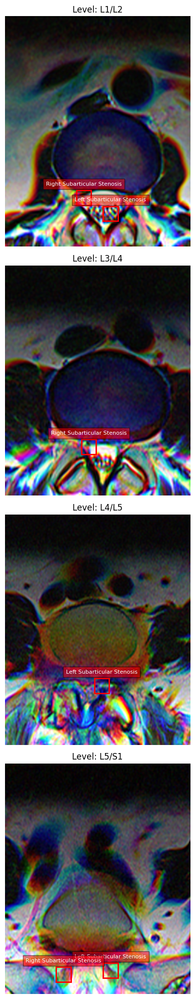

Total coordinates: 6
level
L1/L2    2
L3/L4    1
L4/L5    1
L5/S1    2
dtype: int64

Sample of updated coordinates:
    study_id   series_id  instance_number                    condition  level  \
0  289846404  1791777852               11  Right Subarticular Stenosis  L1/L2   
1  289846404  1791777852               19  Right Subarticular Stenosis  L3/L4   
2  289846404  3787067386               11   Left Subarticular Stenosis  L1/L2   
3  289846404  3787067386               32   Left Subarticular Stenosis  L4/L5   
4  289846404  3787067386               37   Left Subarticular Stenosis  L5/S1   

            x           y series_description  updated    z_value   scan_type  
0  105.829020  243.766091           Axial T2     True  34.281927  individual  
1  112.697152  243.766091           Axial T2     True -48.333497  individual  
2  141.932309  265.158831           Axial T2     True  20.009407  individual  
3  130.119050  229.911018           Axial T2     True -72.035976  individual  
4 

In [31]:
# one complete axial, two partial axial studies, case with wrong labels, case with flipping (up/down)
study_ids = [4003253, 11943292, 208289456, 289846404]

def test_load_axial_t2(study_id: int):
    # Load the axial T2 images
    load_axial_t2(study_id)
    
    # Load the updated coordinates
    updated_coords = pd.read_csv(f'/kaggle/working/Updated_coordinates/{study_id}_axial_t2_coordinates.csv')

    print(updated_coords)
    
    # Load the detected levels with associated z-values from CSV file
    detected_levels_path = f'/kaggle/working/Detected_levels/{study_id}_detected_levels.csv'
    detected_levels_df = pd.read_csv(detected_levels_path)
    
    print("Detected levels with z-values:")
    print(detected_levels_df)

    # Sort the levels by z-value in descending order (top to bottom)
    detected_levels_df = detected_levels_df.sort_values('z_value', ascending=False)
    
    # Extract the sorted levels
    levels = detected_levels_df['level'].tolist()
    
    print("Sorted levels:")
    print(levels)
    
    # Set up the plot
    n_levels = len(levels)
    fig, axes = plt.subplots(n_levels, 1, figsize=(10, 5*n_levels))
    if n_levels == 1:
        axes = [axes]
    
    for i, level in enumerate(levels):
        # Load the combined image for this level
        image_path = f'/kaggle/working/Converted_images/{study_id}/Axial_T2/{level.replace("/", "-")}.png'
        combined_image = cv2.imread(image_path)
        
        # Get coordinates for this level
        level_coords = updated_coords[updated_coords['level'] == level]
        
        # Plot the image
        axes[i].imshow(combined_image)
        axes[i].set_title(f'Level: {level}')
        
        # Plot the coordinates
        for _, coord in level_coords.iterrows():
            rect = plt.Rectangle((coord['x'] - 10, coord['y'] - 10), 20, 20, fill=False, edgecolor='red', linewidth=2)
            axes[i].add_patch(rect)
            axes[i].text(coord['x'], coord['y'] - 15, coord['condition'], color='white', fontsize=8, 
                         bbox=dict(facecolor='red', alpha=0.5), ha='center', va='bottom')
        
        axes[i].axis('off')
    
    plt.tight_layout()
    plt.show()
    
    # Print some information about the updated coordinates
    print(f"Total coordinates: {len(updated_coords)}")
    print(updated_coords.groupby('level').size())
    print("\nSample of updated coordinates:")
    print(updated_coords.head())

# Usage
study_id = study_ids[3]
test_load_axial_t2(study_id)

# Putting it all together

In [32]:
study_ids = train_df['study_id'].unique()

In [33]:
import warnings
warnings.filterwarnings('ignore')

# Function to suppress specific warnings
def ignore_warnings(message="", category=Warning, module="", lineno=0, file="", line=""):
    return True

# Set the warning filter
warnings.showwarning = ignore_warnings

In [34]:
for study_id in tqdm(study_ids):
    study_id_df = train_descriptions[train_descriptions['study_id'] == study_id]
    for _, row in study_id_df.iterrows():
        scan_type = row['series_description']
        series_id = row['series_id']
        was_one_axial_per_series_processed = False
        if scan_type == 'Sagittal T2/STIR':
            load_sagittal_t2(study_id, series_id)
        elif scan_type == 'Sagittal T1':
            load_sagittal_t1(study_id)
        elif scan_type == 'Axial T2' and not was_one_axial_per_series_processed:
            load_axial_t2(study_id)
            was_one_axial_per_series_processed = True

  5%|▍         | 97/1975 [05:02<1:17:08,  2.46s/it]

Invalid instance numbers found for series: {4140564625}


 59%|█████▉    | 1175/1975 [1:00:02<35:08,  2.64s/it]

Invalid instance numbers found for series: {2683794967}


 77%|███████▋  | 1516/1975 [1:16:12<19:06,  2.50s/it]

Invalid instance numbers found for series: {304087230}


 77%|███████▋  | 1530/1975 [1:16:46<16:50,  2.27s/it]

Invalid instance numbers found for series: {1935317419}


 79%|███████▊  | 1555/1975 [1:17:59<17:23,  2.48s/it]

Invalid instance numbers found for series: {890756726}


 90%|████████▉ | 1776/1975 [1:28:43<08:55,  2.69s/it]

Invalid instance numbers found for series: {3911532570}


100%|██████████| 1975/1975 [1:38:38<00:00,  3.00s/it]


## Saving new coordinates

In [35]:
new_sagittal_t2_coordinates.to_csv('Updated_coordinates/new_sagittal_t2_coordinates.csv', index = False)
new_sagittal_t1_coordinates.to_csv('Updated_coordinates/new_sagittal_t1_coordinates.csv', index = False)
new_axial_t2_coordinates.to_csv('Updated_coordinates/new_axial_t2_coordinates.csv', index = False)